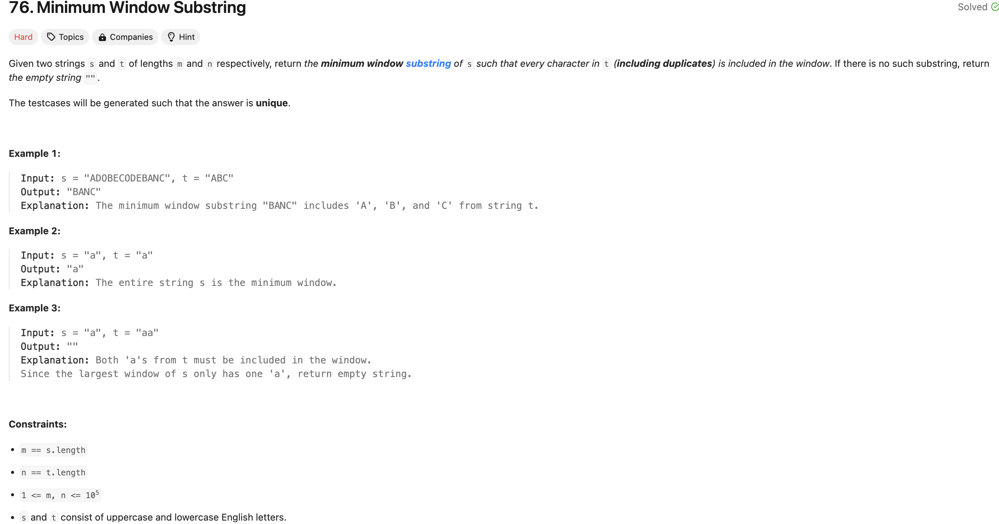

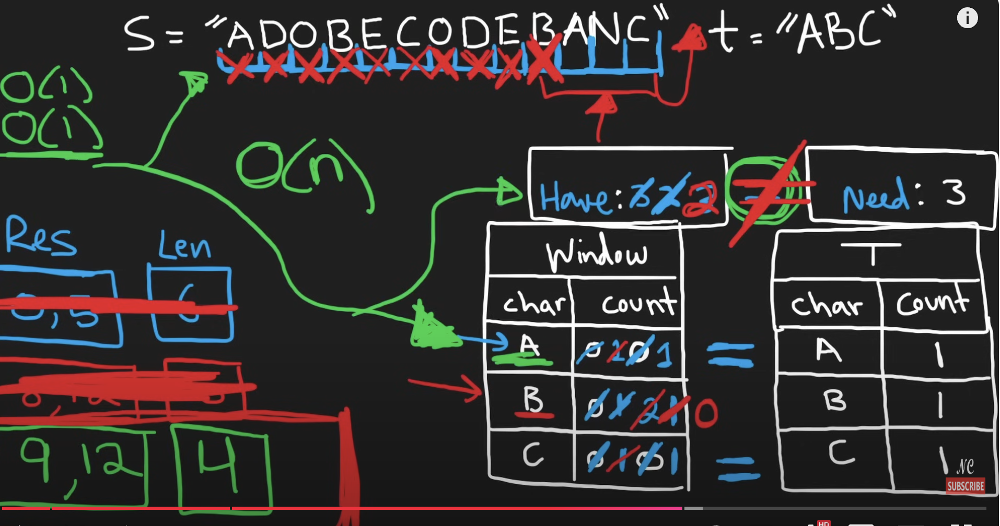

In [33]:
from collections import Counter
from math import inf

class Solution:
    def minWindow(self, source: str, target: str) -> str:
        # Create a counter for the target to keep a record of each character's frequency
        target_counter = Counter(target)
        window_counter = Counter()  # This will keep a count of characters in the current window
        valid_char_count = 0       # Number of characters that meet the target criteria
        left = 0                   # Left pointer to shrink the window
        min_left = -1              # Left boundary index of the minimum window
        min_size = inf             # Initialize min_size to positive infinity

        # Iterate over each character in the source string
        for right, char in enumerate(source):
            # Include current character in the window
            window_counter[char] += 1
            #print("window_counter",window_counter, "target_counter",target_counter)
            
            #print(target_counter[char],window_counter[char])

            # If the current character is needed and the window contains enough of this character
            if target_counter[char] >= window_counter[char]:
                valid_char_count += 1

                #print("char",char,"valid_char_count",valid_char_count)
          
            # If the window has all the characters needed
            while valid_char_count == len(target):
                # If this window is smaller than the minimum so far, update minimum size and index
                if right - left + 1 < min_size:
                    min_size = right - left + 1
                    min_left = left
              
                # If the character at the left pointer is less frequent in the window than in the target,
                # reducing it further would break the window condition
                if target_counter[source[left]] >= window_counter[source[left]]:
                    valid_char_count -= 1
                    #print("char",source[left],"valid_char_count",valid_char_count)
              
                # Shrink the window from the left
                window_counter[source[left]] -= 1
                left += 1
      
        # If no window meets the criteria, return an empty string
        return '' if min_left < 0 else source[min_left:min_left + min_size]

In [34]:
s=Solution()
s.minWindow("XDOBECODEBANC", "ABCB")
s.minWindow("a", "aa")

''

************************************************************************************************************************************************************************************************************

![Screenshot 2024-12-21 at 4.49.51 PM.png](<attachment:Screenshot 2024-12-21 at 4.49.51 PM.png>)
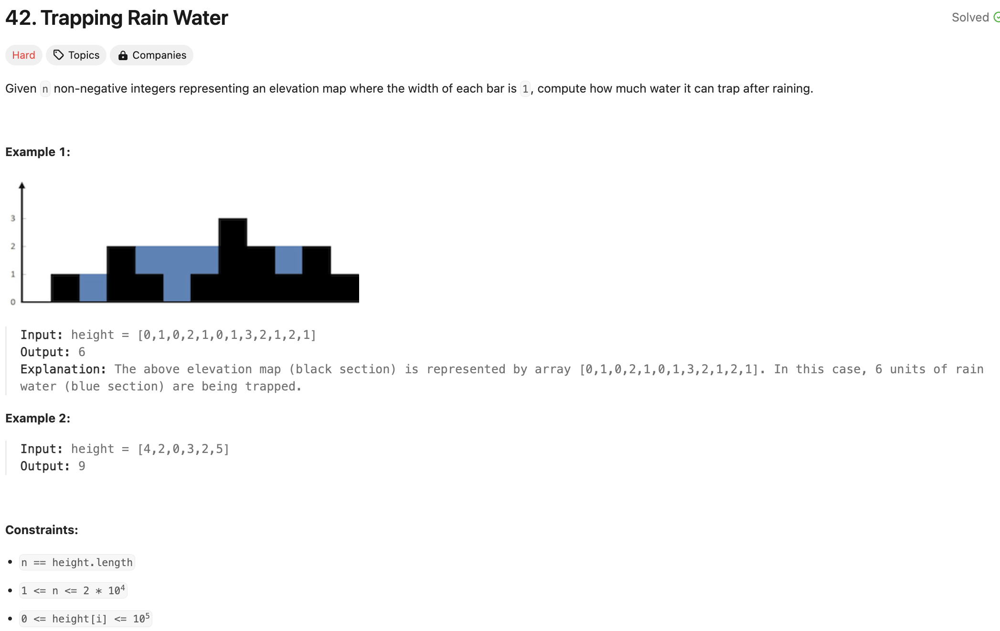

![Screenshot 2024-12-21 at 5.08.59 PM.png](<attachment:Screenshot 2024-12-21 at 5.08.59 PM.png>)
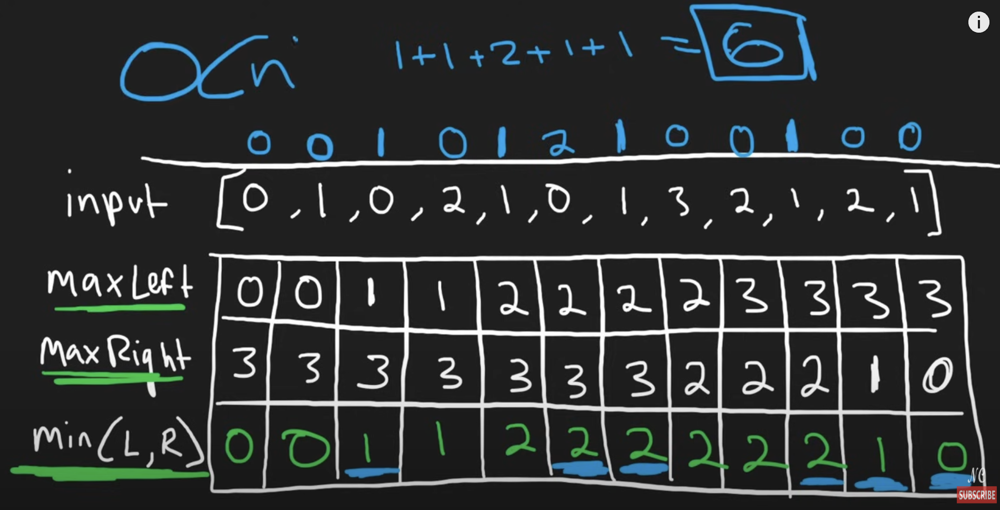

### At location i will have min(maxleft,maxRight) - h[i] if min(maxleft,maxRight) - h[i]>0

In [56]:
from itertools import accumulate
from typing import List
class Solution:
    def trap(self, height: List[int]) -> int:
        maxl = [0] * len(height)
        maxr = [0] * len(height)
        minlr = [0] * len(height)

        maxln = 0
        maxl[0] = 0
        for i in range(1, len(height), 1):
            maxln = max(maxln, height[i - 1])
            maxl[i] = maxln

        maxrn = 0
        for i in range(len(height) - 2, -1, -1):
            maxrn = max(maxrn, height[i + 1])
            maxr[i] = maxrn

        res = 0
        for i in range(len(height)):
            temp = min(maxl[i], maxr[i]) - height[i]
            if temp > 0:
                res += temp

        return res



In [57]:
height = [0,1,0,2,1,0,1,3,2,1,2,1]
call=Solution()
call.trap(height)

6

####  2nd approch with 2 pointer

we can move left pointer without knowing rightMAX bcz it need min(leftMAX,rightMAX) same happen from right side

![Screenshot 2024-12-21 at 5.38.28 PM.png](<attachment:Screenshot 2024-12-21 at 5.38.28 PM.png>)
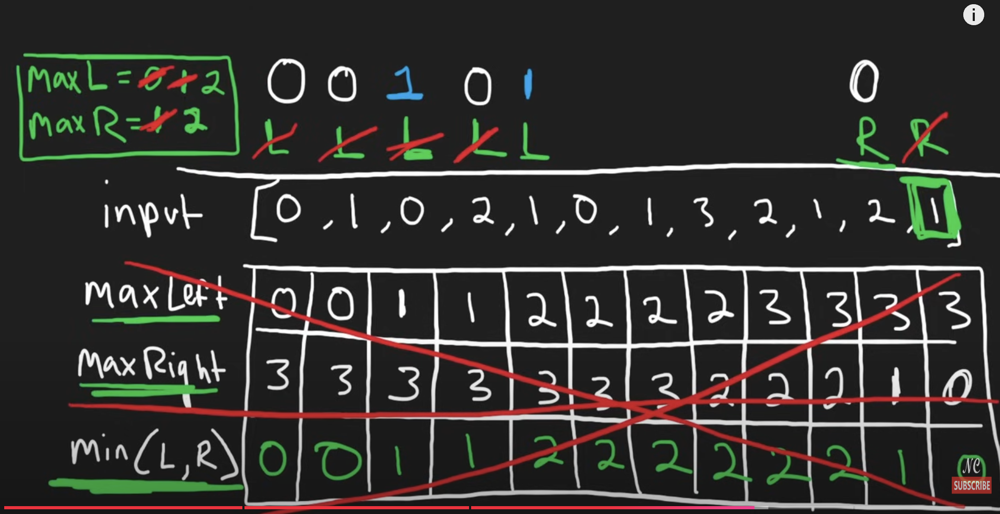

In [86]:
from itertools import accumulate
from typing import List
class Solution:
    def trap(self, height: List[int]) -> int:
        if not height:
            return 0
        maxl = height[0]
        maxr = height[-1]
        left=0
        right=len(height)-1
        result=0

        while left<right:
            if maxl<=maxr:
                left+=1
                maxl=max(maxl,height[left])
                result+= maxl - height[left]
            else:
                right-=1
                maxr=max(maxr,height[right])
                result+= maxr - height[right]
        return result

In [87]:
height = [0,1,0,2,1,0,1,3,2,1,2,1]
call=Solution()
call.trap(height)

6

************************************************************************************************************************************************************************************************************

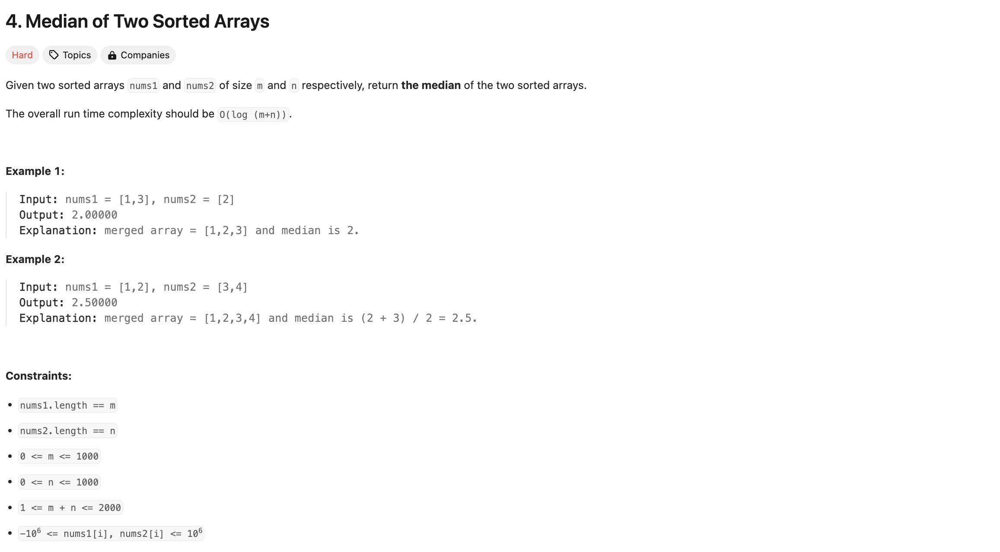

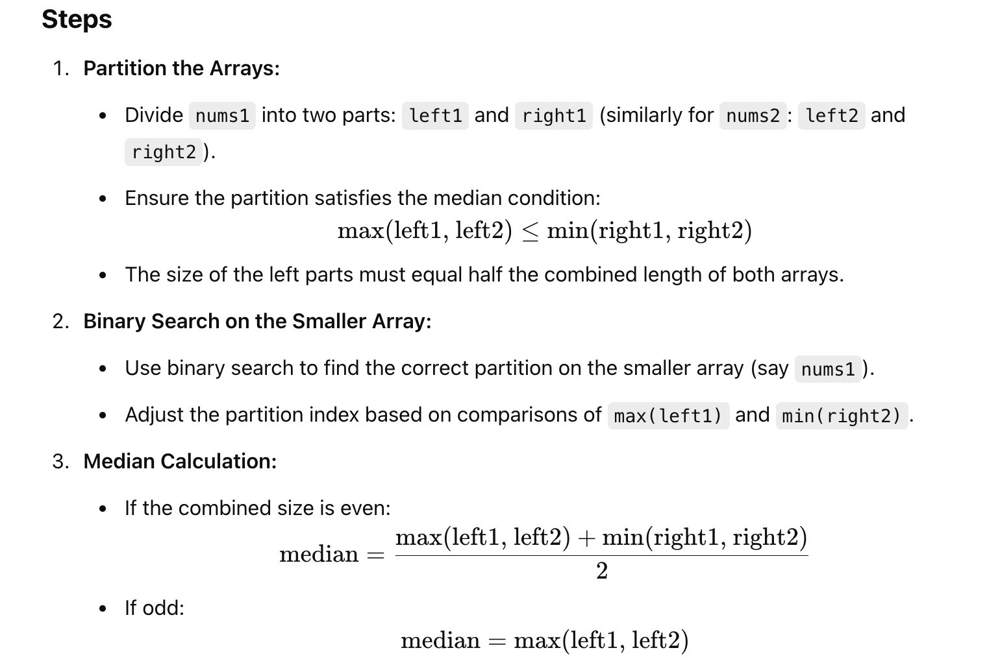

In [5]:
def findMedianSortedArrays(nums1, nums2):
    # Ensure nums1 is the smaller array
    if len(nums1) > len(nums2):
        nums1, nums2 = nums2, nums1

    m, n = len(nums1), len(nums2)
    total_length = m + n
    half_length = total_length // 2

    left, right = 0, m
    while left <= right:
        partition1 = (left + right) // 2
        partition2 = half_length - partition1

        # Handle edge cases where partitions are out of bounds
        max_left1 = nums1[partition1 - 1] if partition1 > 0 else float('-inf')
        min_right1 = nums1[partition1] if partition1 < m else float('inf')

        max_left2 = nums2[partition2 - 1] if partition2 > 0 else float('-inf')
        min_right2 = nums2[partition2] if partition2 < n else float('inf')

        # Check if we have found the correct partition
        if max_left1 <= min_right2 and max_left2 <= min_right1:
            if total_length % 2 == 0:
                return (max(max_left1, max_left2) + min(min_right1, min_right2)) / 2
            else:
                return max(max_left1, max_left2)
        elif max_left1 > min_right2:
            # Move partition1 to the left
            right = partition1 - 1
        else:
            # Move partition1 to the right
            left = partition1 + 1

    raise ValueError("Input arrays are not sorted!")


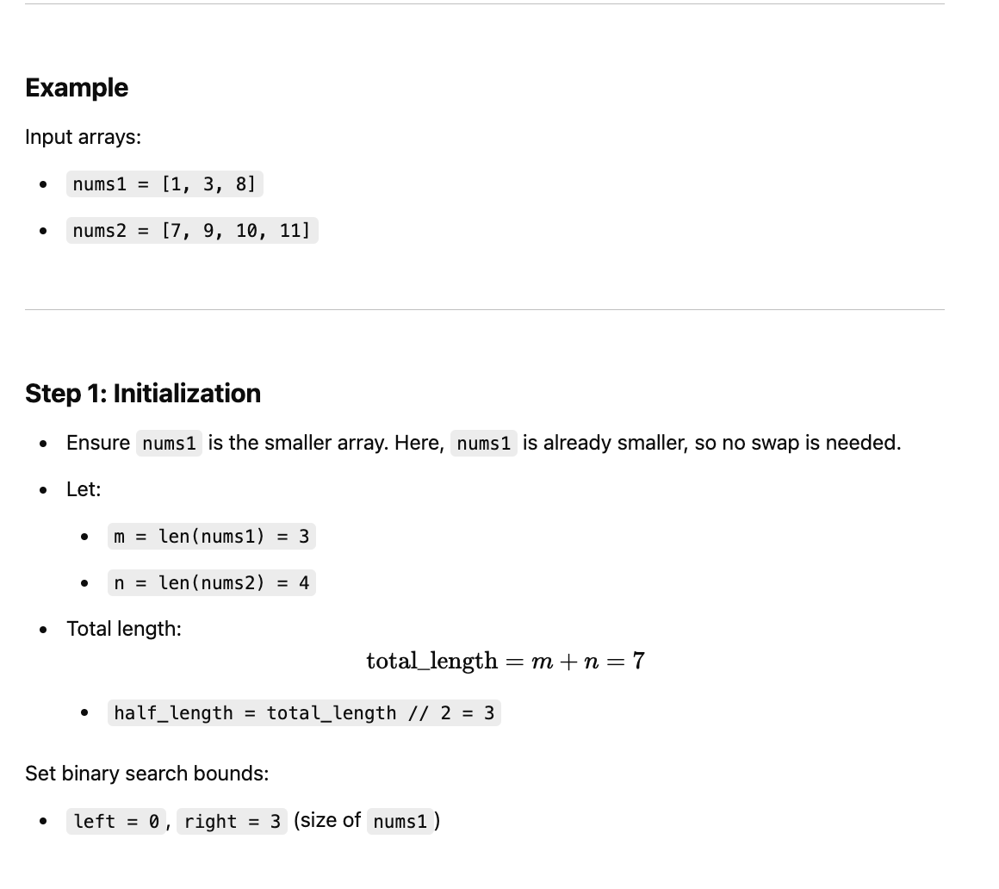

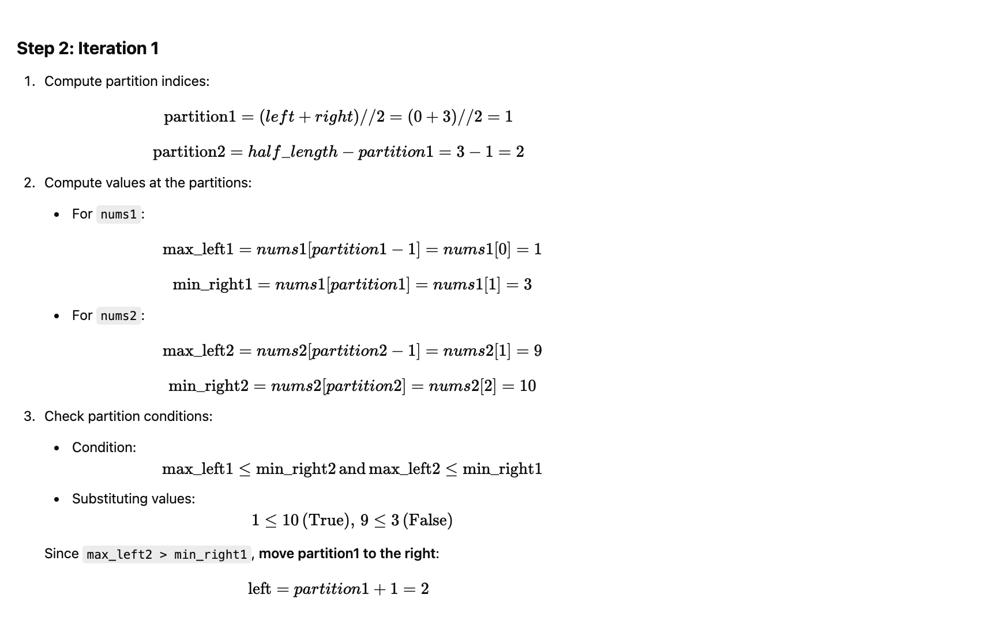

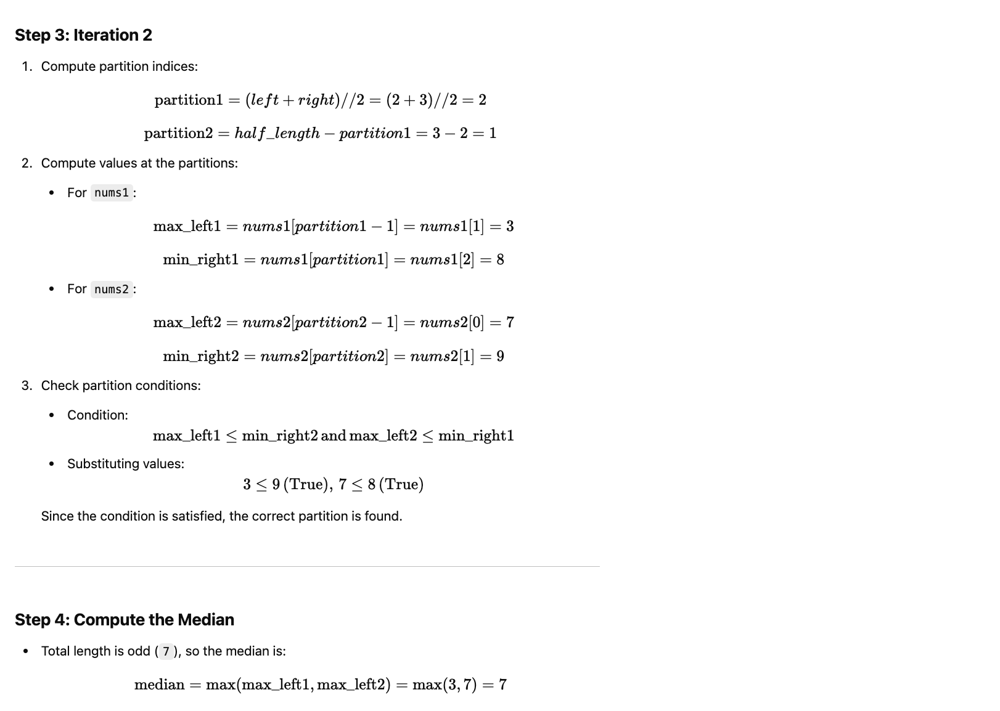

************************************************************************************************************************************************************************************************************

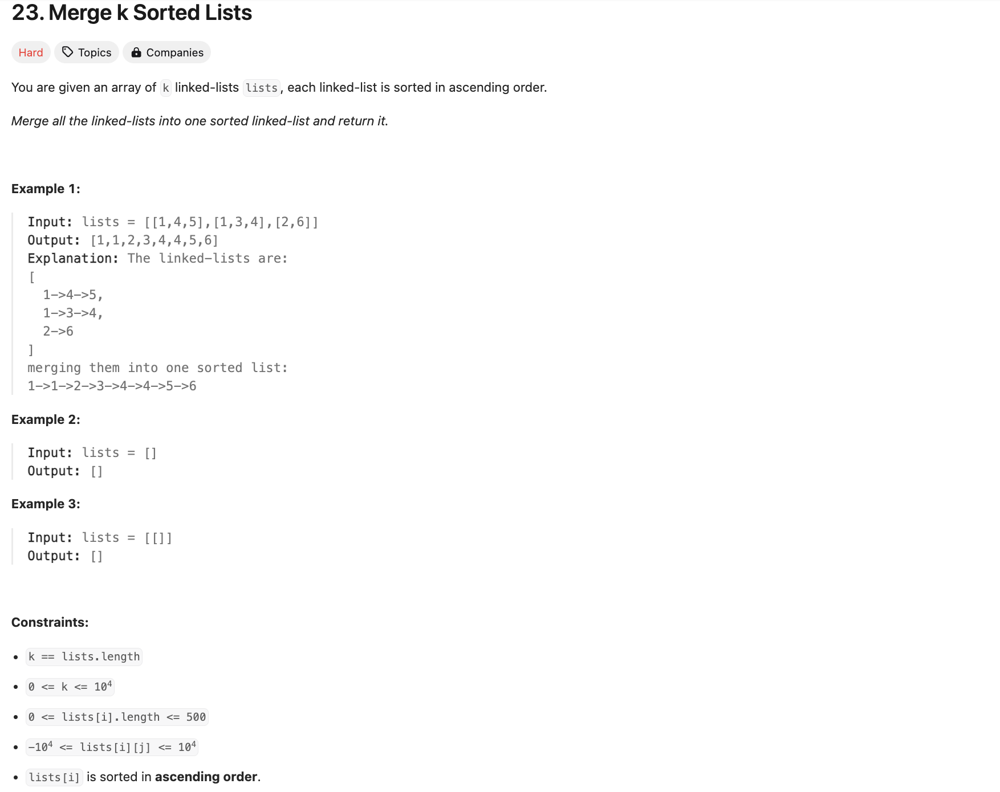

In [20]:
from typing import List, Optional
from queue import PriorityQueue

class ListNode:
    def __init__(self, val=0, next=None):
        self.val = val
        self.next = next

    def __lt__(self, other):
        return self.val < other.val

class Solution:
    def mergeKLists(self, lists: List[Optional[ListNode]]) -> Optional[ListNode]:
        pq = PriorityQueue()

        # Add the head of each list to the priority queue
        for i, head in enumerate(lists):
            if head:
                pq.put((head.val, i, head))

        # Dummy node to simplify the merging process
        dummy_node = current = ListNode()

        # Process the priority queue
        while not pq.empty():
            _, i, node = pq.get()

            # Add the smallest node to the merged list
            current.next = node
            current = current.next

            # If there's a next node, add it to the priority queue
            if node.next:
                pq.put((node.next.val, i, node.next))

        # Return the head of the merged list
        return dummy_node.next

In [21]:
class ListNode:
    def __init__(self, val=0, next=None):
        self.val = val
        self.next = next

def create_linked_list(arr):
    if not arr:
        return None
    head = ListNode(arr[0])
    current = head
    for val in arr[1:]:
        current.next = ListNode(val)
        current = current.next
    return head

def print_linked_list(head):
    result = []
    while head:
        result.append(head.val)
        head = head.next
    return result

lists = [
    create_linked_list([1, 4, 5]),
    create_linked_list([1, 3, 4]),
    create_linked_list([2, 6])
]

s=Solution()

merged_head = s.mergeKLists(lists)

In [22]:
print_linked_list(merged_head)

[1, 1, 2, 3, 4, 4, 5, 6]

************************************************************************************************************************************************************************************************************

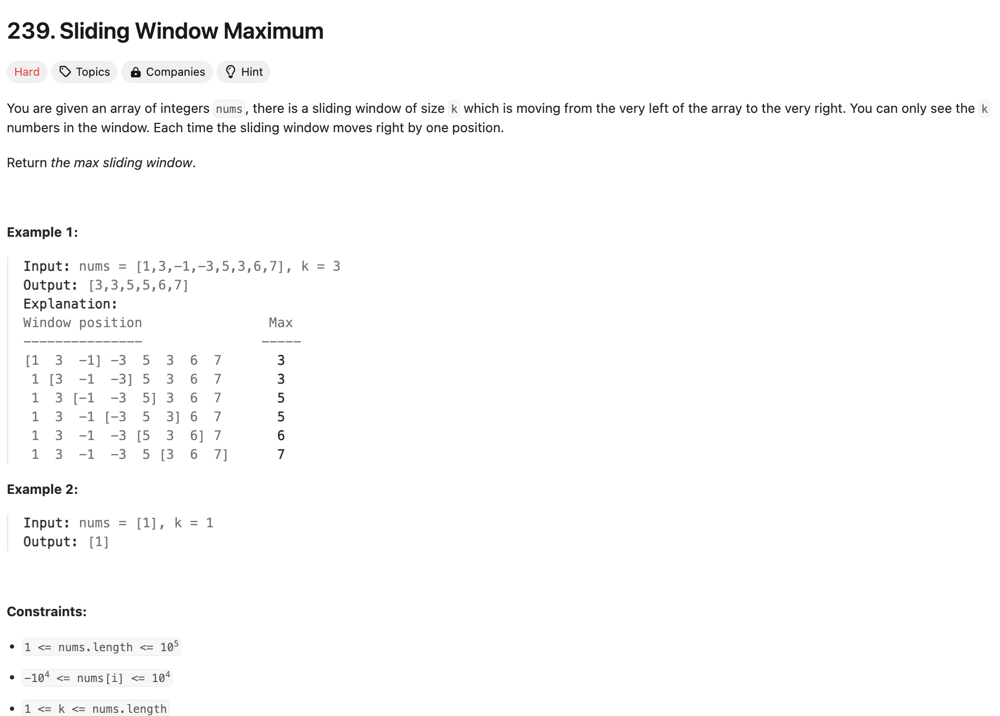

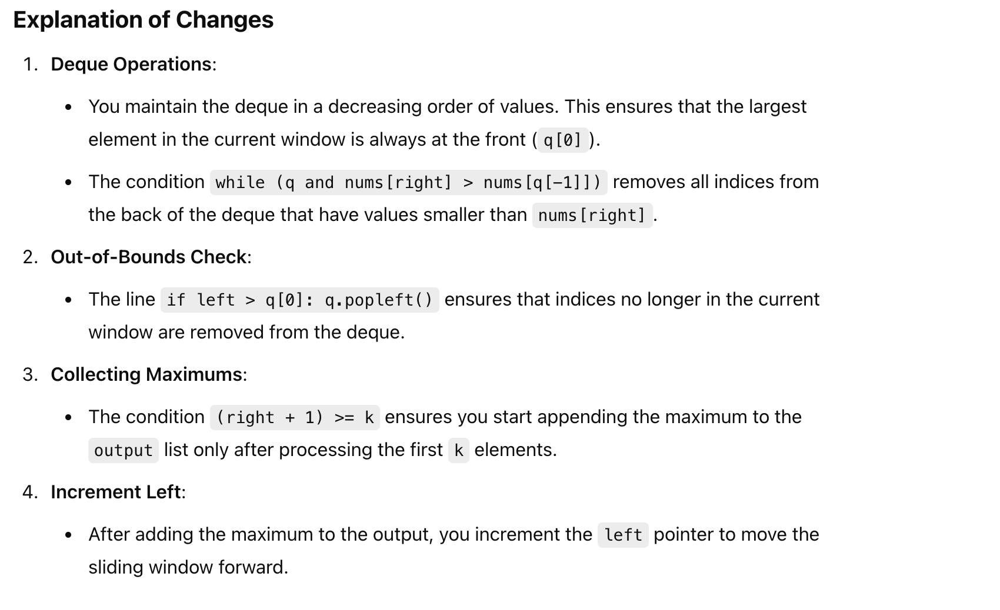

In [23]:
from collections import deque
from typing import List

class Solution:
    def maxSlidingWindow(self, nums: List[int], k: int) -> List[int]:
        output = []
        q = deque()  # To store indices of elements in the current window
        left, right = 0, 0

        while right < len(nums):
            # Remove indices from the back of the deque if the current number is larger
            while q and nums[right] > nums[q[-1]]:
                q.pop()

            # Add the current index to the deque
            q.append(right)

            # Remove the leftmost index if it is out of the bounds of the sliding window
            if left > q[0]:
                q.popleft()

            # Start recording the maximum value once the first `k` elements have been processed
            if (right + 1) >= k:
                output.append(nums[q[0]])  # The max element in the current window
                left += 1  # Move the left boundary of the window
            
            # Move the right boundary of the window
            right += 1

        return output

In [24]:
# Test case 1
nums = [1,3,-1,-3,5,3,6,7]
k = 3
print(Solution().maxSlidingWindow(nums, k))  # Output: [3, 3, 5, 5, 6, 7]

# Test case 2
nums = [1]
k = 1
print(Solution().maxSlidingWindow(nums, k))  # Output: [1]

# Test case 3
nums = [9,11]
k = 2
print(Solution().maxSlidingWindow(nums, k))  # Output: [11]

# Test case 4
nums = [4,3,2,1]
k = 2
print(Solution().maxSlidingWindow(nums, k))  # Output: [4, 3, 2]

[3, 3, 5, 5, 6, 7]
[1]
[11]
[4, 3, 2]


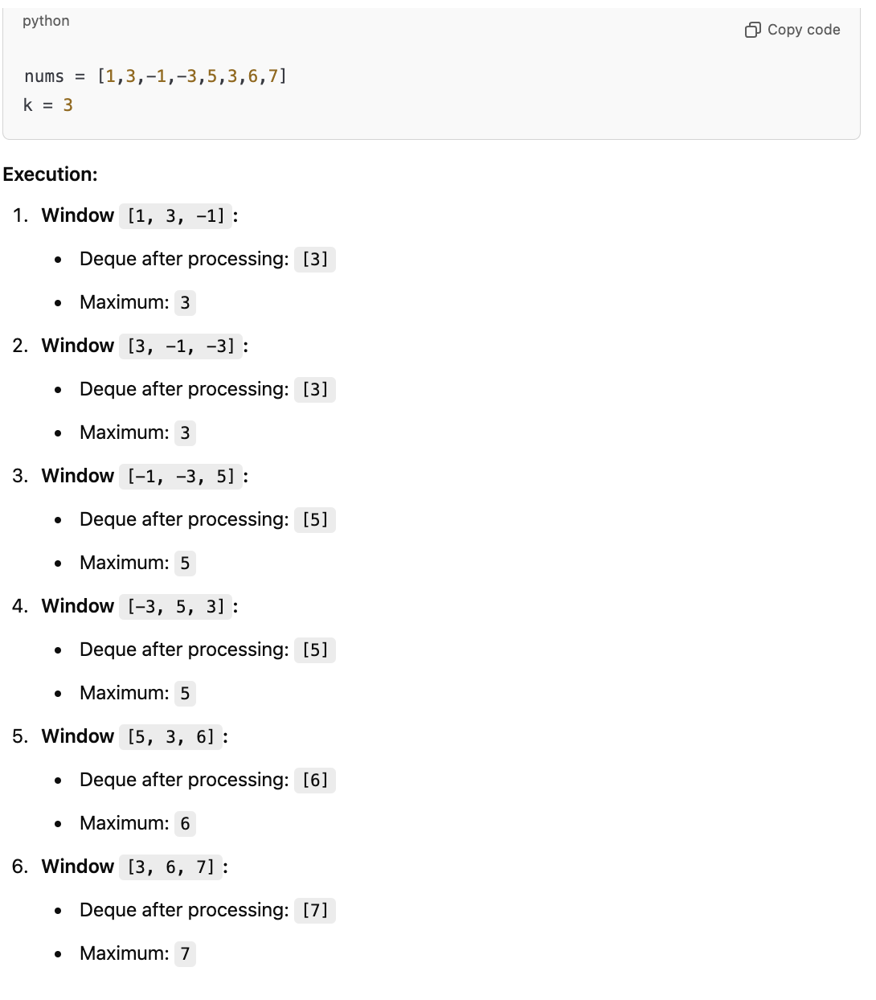

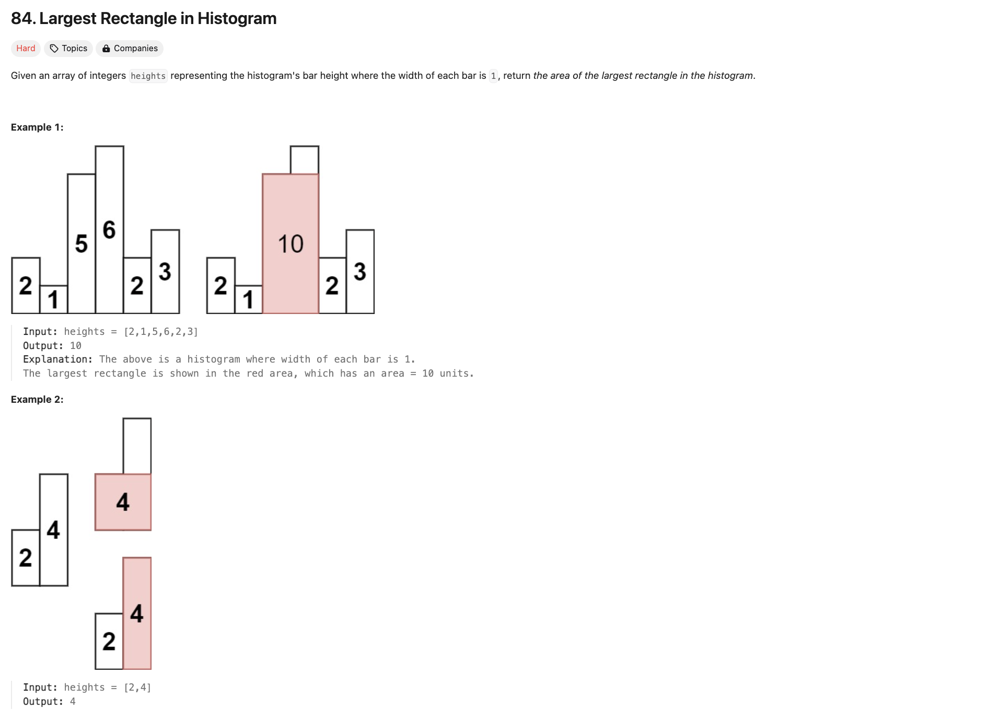

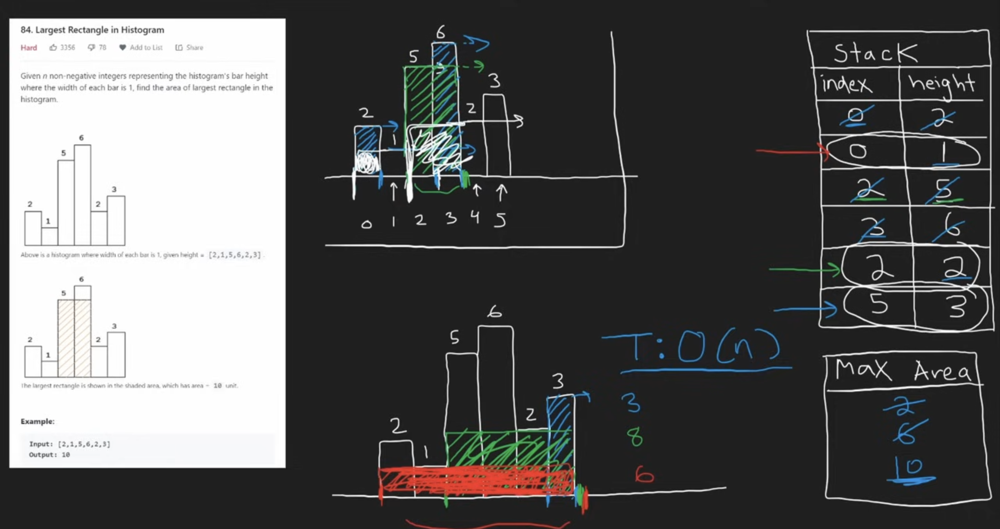

In [25]:
class Solution:
    def largestRectangleArea(self, heights: List[int]) -> int:
        # Initialize a stack to keep track of (index, height) for histogram bars
        stack = []
        
        # Variable to keep track of the maximum area found so far
        MaxArea = 0

        # Iterate through the histogram bars by index and height
        for i, h in enumerate(heights):
            start = i  # This variable tracks the leftmost index where the current height could extend
            
            # If the current height is less than the height of the bar at the top of the stack,
            # pop the stack and calculate the area of the rectangle with the popped height.
            while stack and stack[-1][1] > h:
                index, height = stack.pop()
                # Calculate area with height as the shortest bar and update MaxArea
                MaxArea = max(MaxArea, height * (i - index))
                # Update the start index to the index of the popped bar
                start = index
            
            # Push the current bar (start index, height) onto the stack
            stack.append((start, h))

        # Process remaining bars in the stack
        for i, h in stack:
            # Calculate the area for bars extending to the end of the histogram
            MaxArea = max(MaxArea, h * (len(heights) - i))
        
        # Return the maximum area found
        return MaxArea


In [26]:
heights = [2, 1, 5, 6, 2, 3]
sol = Solution()
print(sol.largestRectangleArea(heights))  

10


************************************************************************************************************************************************************************************************************

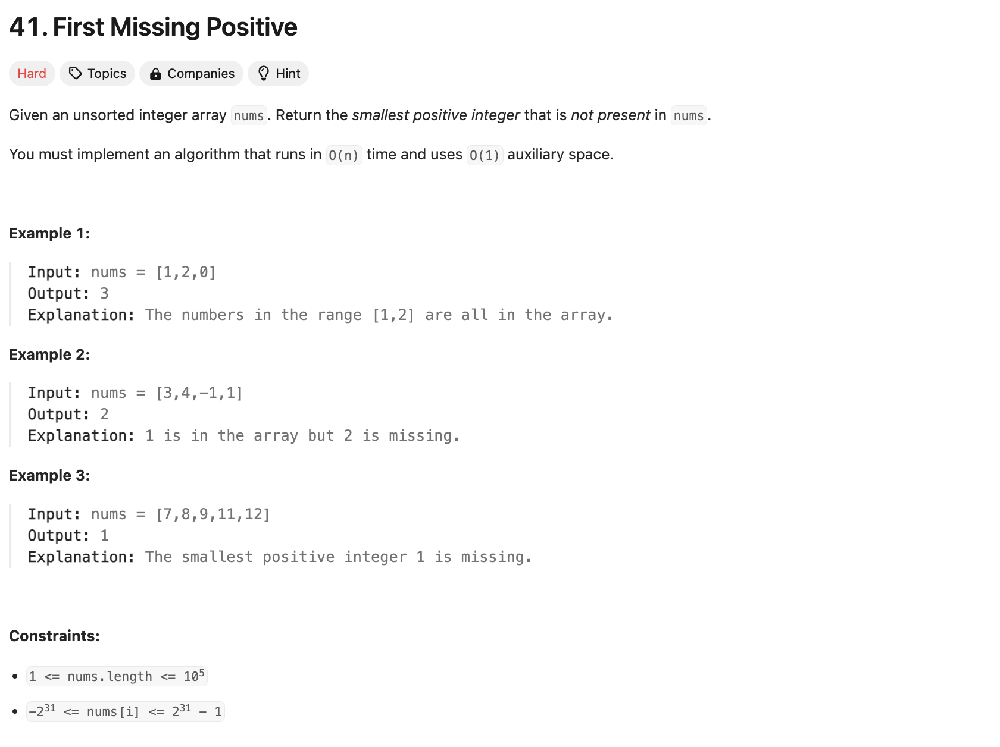

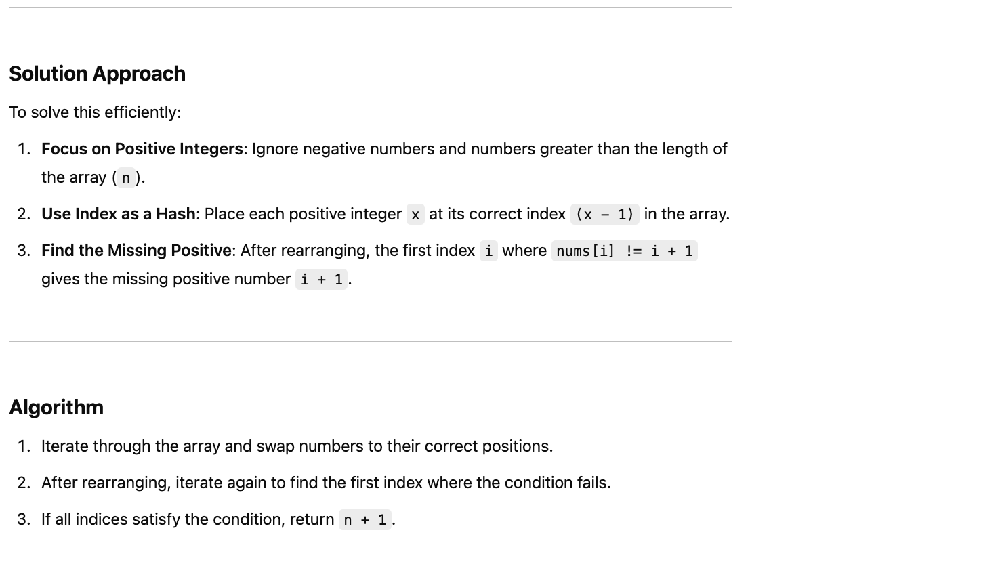

In [27]:
def first_missing_positive(nums):
    n = len(nums)
    
    # Place each number in its correct position if possible
    for i in range(n):
        while 1 <= nums[i] <= n and nums[nums[i] - 1] != nums[i]:
            # Swap nums[i] with the number at its correct position
            nums[nums[i] - 1], nums[i] = nums[i], nums[nums[i] - 1]
    
    # Find the first missing positive
    for i in range(n):
        if nums[i] != i + 1:
            return i + 1
    
    # If all numbers are in their correct positions
    return n + 1

# Example Usage
print(first_missing_positive([1, 2, 0]))        # Output: 3
print(first_missing_positive([3, 4, -1, 1]))   # Output: 2
print(first_missing_positive([7, 8, 9, 11, 12])) # Output: 1


3
2
1


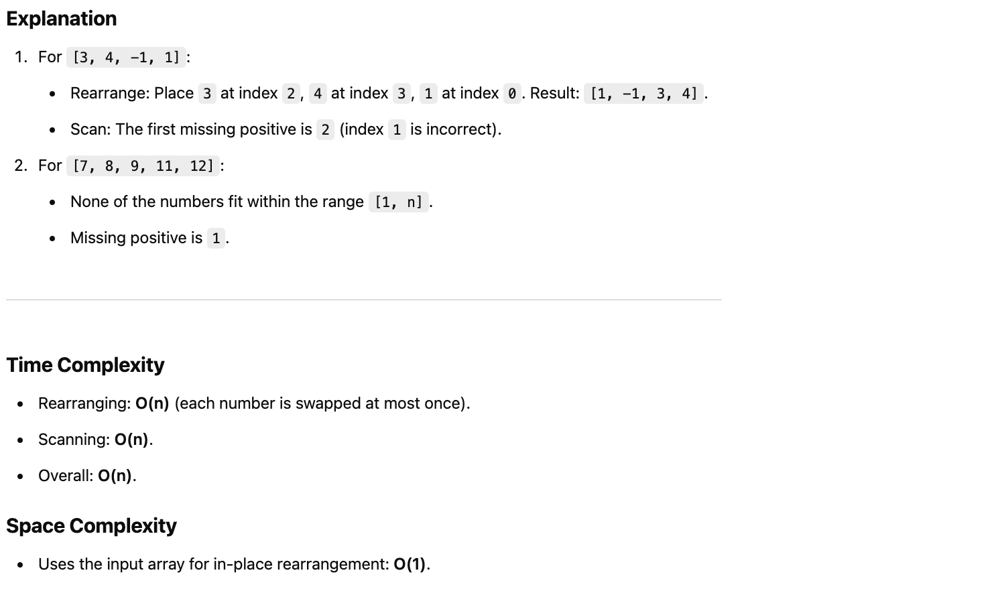

************************************************************************************************************************************************************************************************************

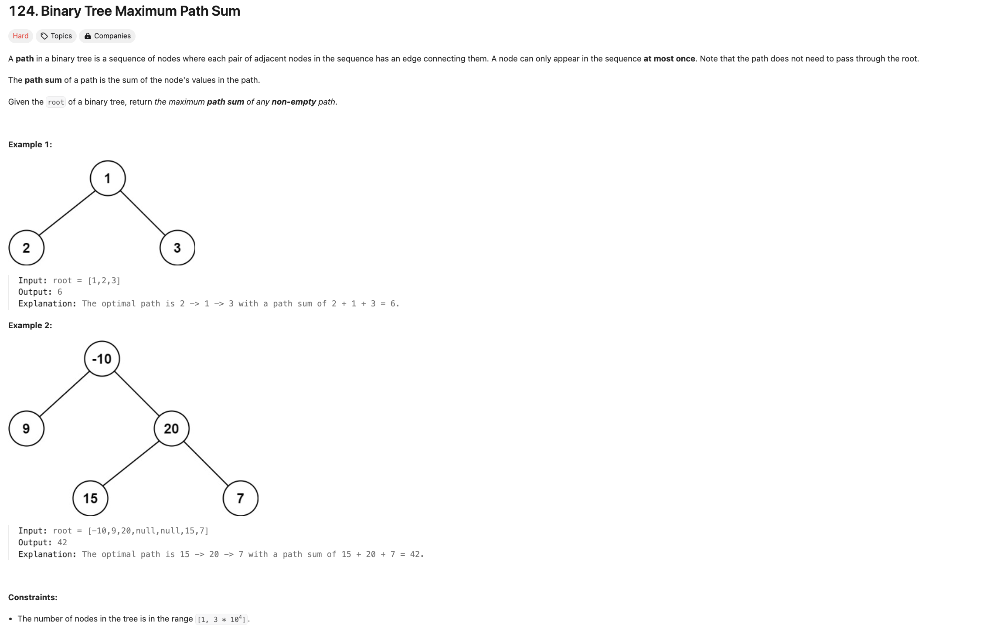

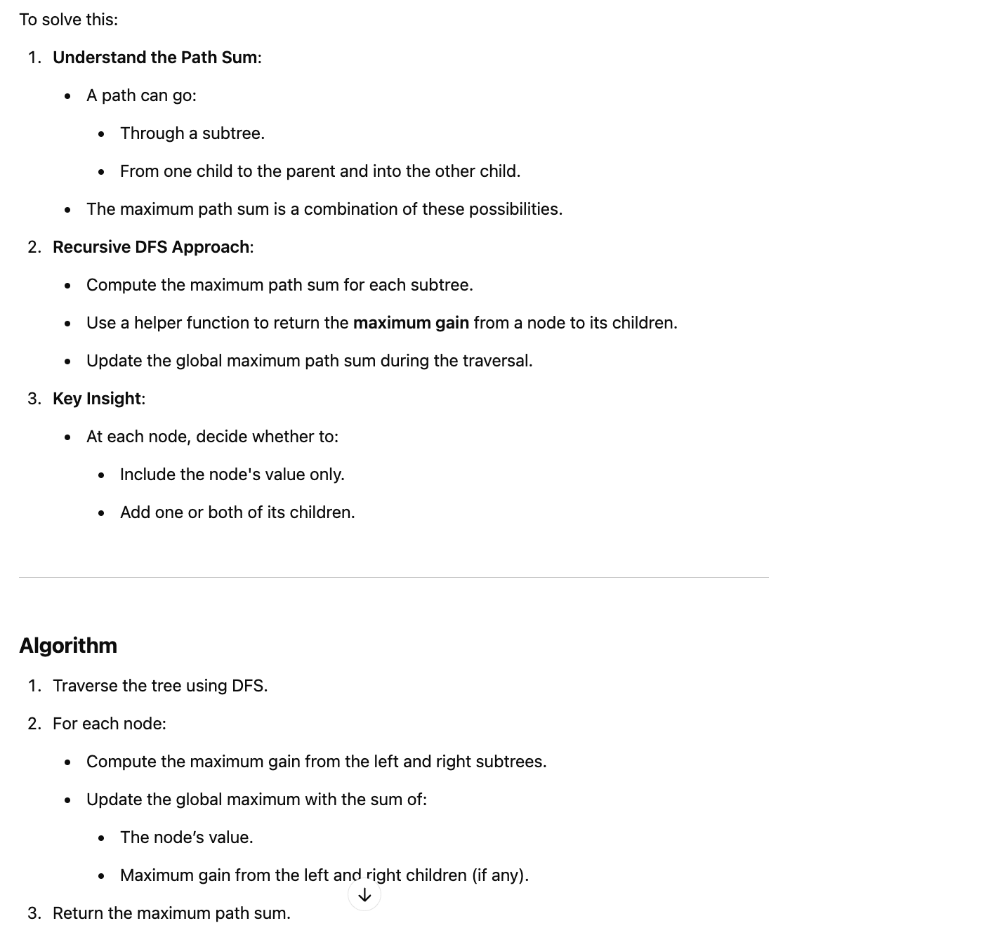

In [28]:
class TreeNode:
    def __init__(self, val=0, left=None, right=None):
        self.val = val
        self.left = left
        self.right = right

def max_path_sum(root):
    global_max = float('-inf')  # Initialize global maximum
    
    def dfs(node):
        nonlocal global_max
        if not node:
            return 0
        
        # Compute the maximum path sum through left and right subtrees
        left_max = max(dfs(node.left), 0)  # Ignore negative paths
        right_max = max(dfs(node.right), 0)
        
        # Update global maximum path sum
        current_max = node.val + left_max + right_max
        global_max = max(global_max, current_max)
        
        # Return the maximum gain to parent
        return node.val + max(left_max, right_max)
    
    dfs(root)
    return global_max

# Example Usage
# Tree:      -10
#           /  \
#          9   20
#             /  \
#            15   7
root = TreeNode(-10)
root.left = TreeNode(9)
root.right = TreeNode(20, TreeNode(15), TreeNode(7))

print(max_path_sum(root))  # Output: 42


42


![Screenshot 2024-12-23 at 1.02.20 PM.png](<attachment:Screenshot 2024-12-23 at 1.02.20 PM.png>)
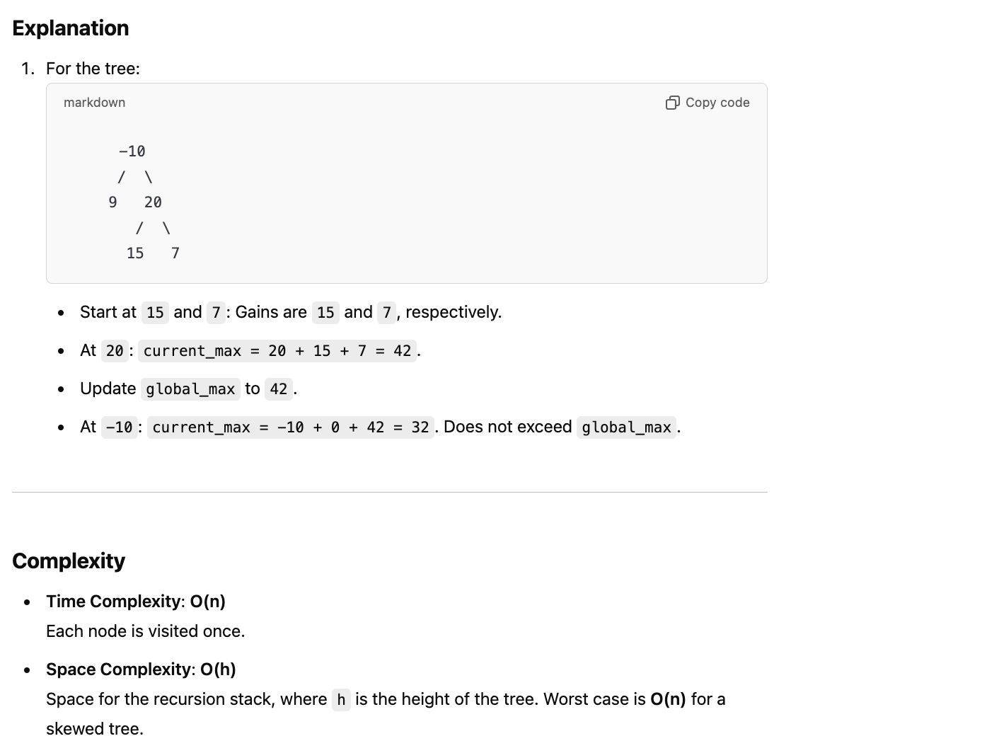

************************************************************************************************************************************************************************************************************

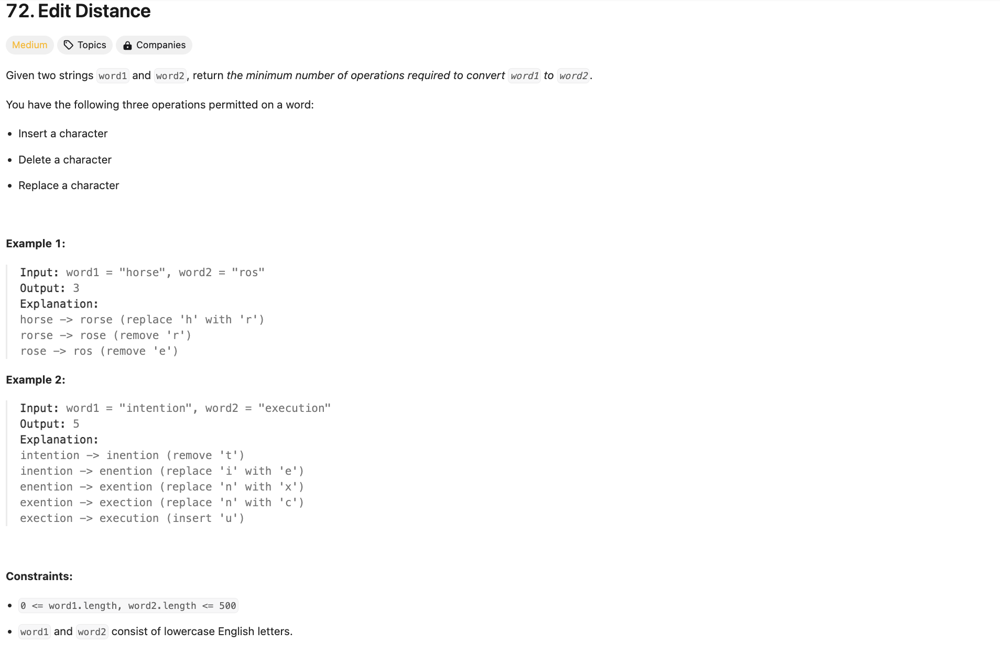

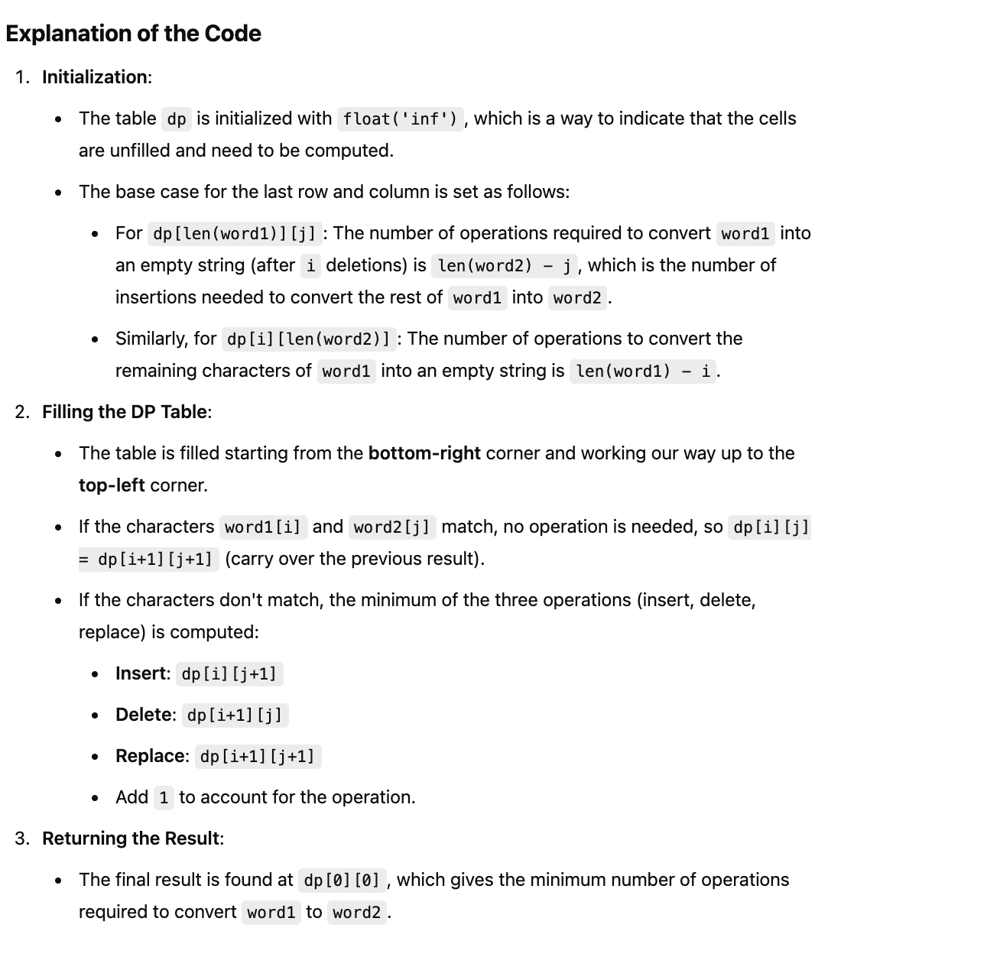

In [29]:
class Solution:
    def minDistance(self, word1: str, word2: str) -> int:
        # Initialize the DP table with 'inf' (to simulate uninitialized cells)
        dp = [[float('inf')] * (len(word2) + 1) for _ in range(len(word1) + 1)]

        # Base case for the last row (conversion from word1 to an empty string)
        for j in range(len(word2) + 1):
            dp[len(word1)][j] = len(word2) - j
        
        # Base case for the last column (conversion from an empty string to word1)
        for i in range(len(word1) + 1):
            dp[i][len(word2)] = len(word1) - i

        # Fill the DP table by iterating from bottom-right to top-left
        for i in range(len(word1) - 1, -1, -1):
            for j in range(len(word2) - 1, -1, -1):
                if word1[i] == word2[j]:
                    dp[i][j] = dp[i + 1][j + 1]  # No operation needed if characters match
                else:
                    dp[i][j] = 1 + min(dp[i + 1][j], dp[i][j + 1], dp[i + 1][j + 1])  # Min of insert, delete, replace

        return dp[0][0]  # The final result is at the top-left corner


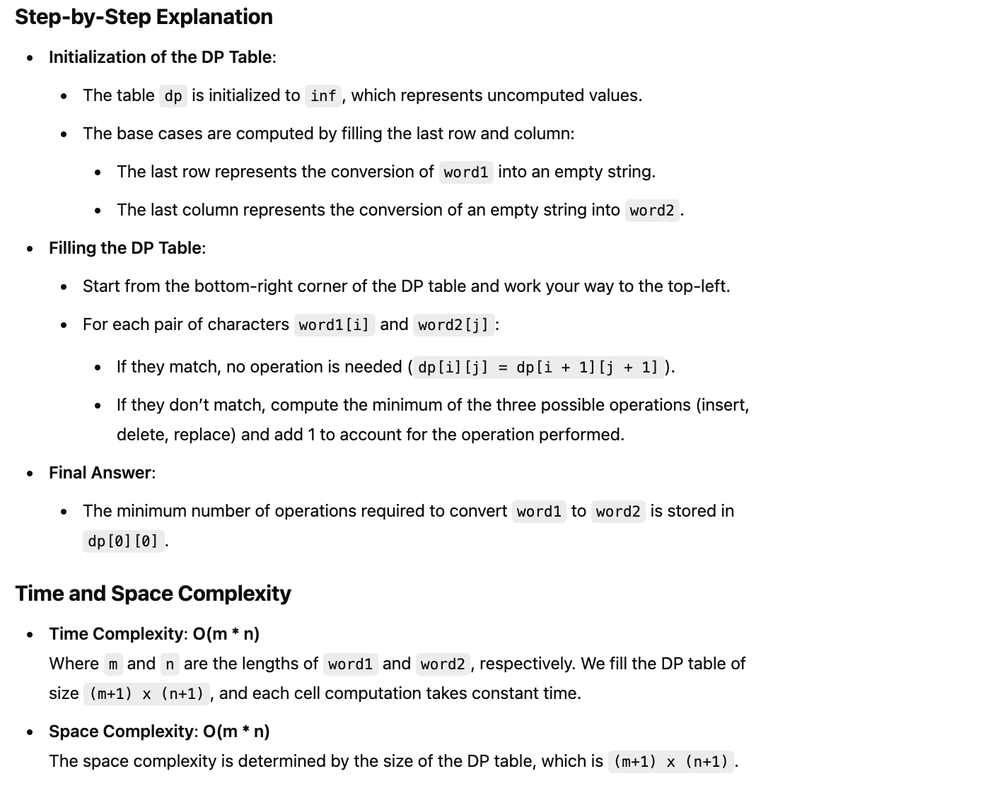

************************************************************************************************************************************************************************************************************

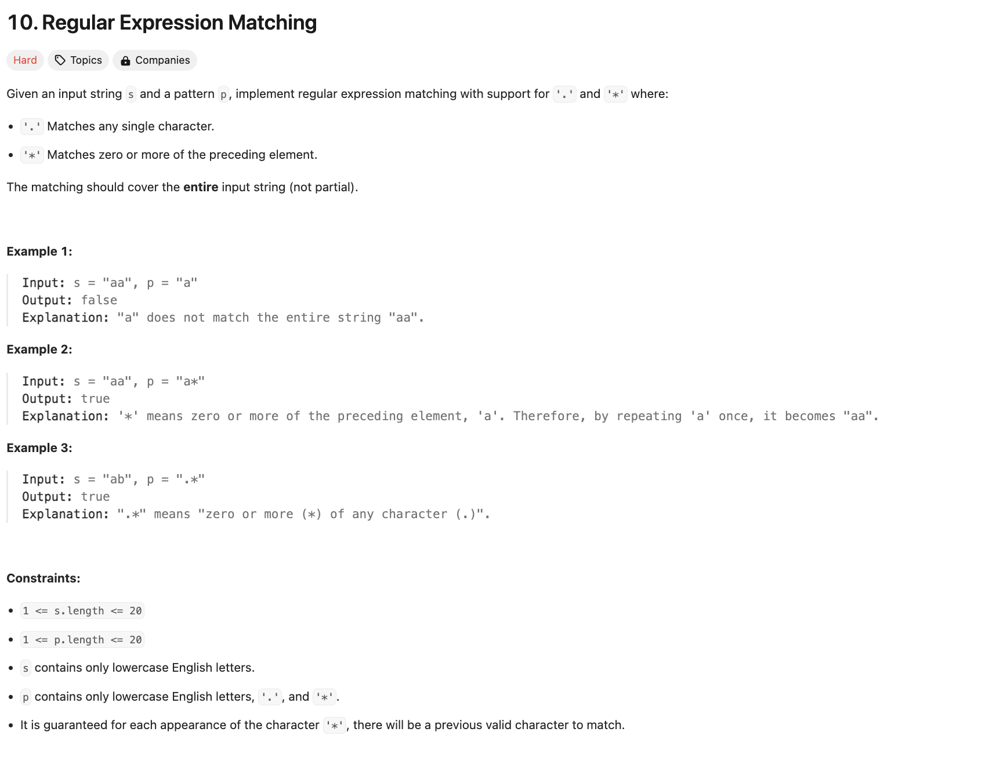

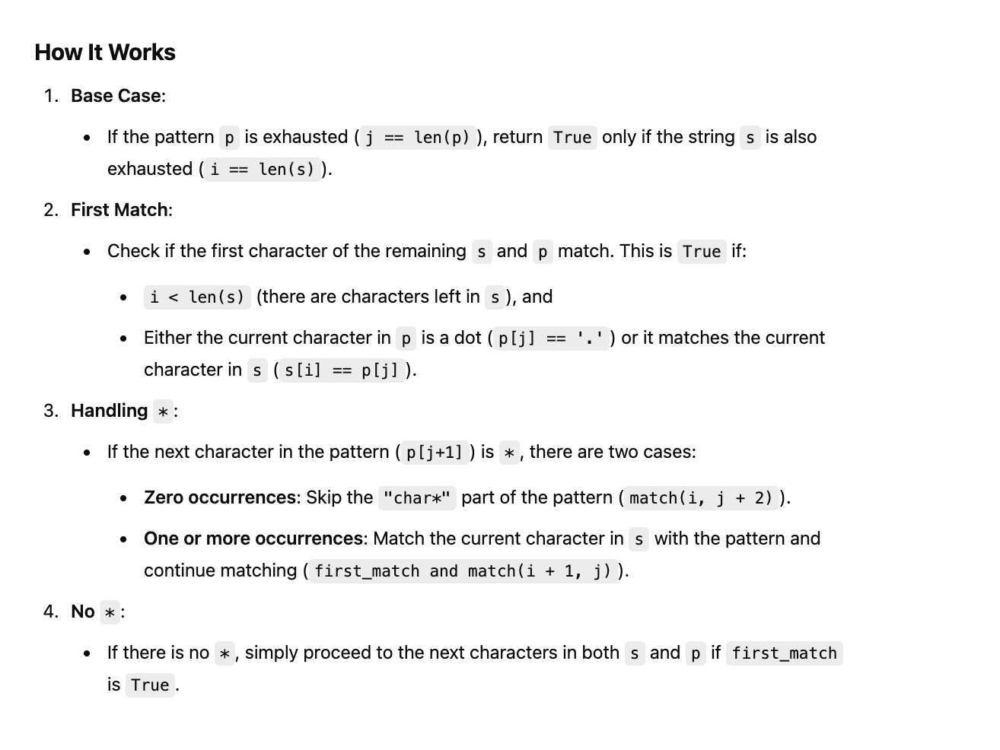

In [30]:
class Solution:
    def isMatch(self, s: str, p: str) -> bool:
        def match(i: int, j: int) -> bool:
            # Base case: If we've processed the entire pattern
            if j == len(p):
                return i == len(s)

            # Check if the first character of s and p match
            first_match = i < len(s) and (s[i] == p[j] or p[j] == '.')

            # Handle '*' in the pattern
            if j + 1 < len(p) and p[j + 1] == '*':
                # Two options:
                # 1. Skip the "char*" in the pattern (match zero occurrences)
                # 2. Use the '*' to match one or more of the current char in s
                return (match(i, j + 2) or
                        (first_match and match(i + 1, j)))
            else:
                # If there's no '*', move both pointers if the characters match
                return first_match and match(i + 1, j + 1)

        # Start the recursion from the beginning of both strings
        return match(0, 0)


In [31]:
s = "aab"
p = "c*a*b"
solution = Solution()
print(solution.isMatch(s, p))  # Output: True


True


Optimizing with Memoization
To optimize this recursive approach, we can use memoization to store results for overlapping subproblems.

In [33]:
class Solution:
    def isMatch(self, s: str, p: str) -> bool:
        memo = {}

        def match(i: int, j: int) -> bool:
            if (i, j) in memo:
                return memo[(i, j)]

            if j == len(p):
                result = i == len(s)
            else:
                first_match = i < len(s) and (s[i] == p[j] or p[j] == '.')
                if j + 1 < len(p) and p[j + 1] == '*':
                    result = (match(i, j + 2) or
                              (first_match and match(i + 1, j)))
                else:
                    result = first_match and match(i + 1, j + 1)

            memo[(i, j)] = result
            return result

        return match(0, 0)


In [34]:
s = "aab"
p = "c*a*b"
solution = Solution()
print(solution.isMatch(s, p))  # Output: True

True


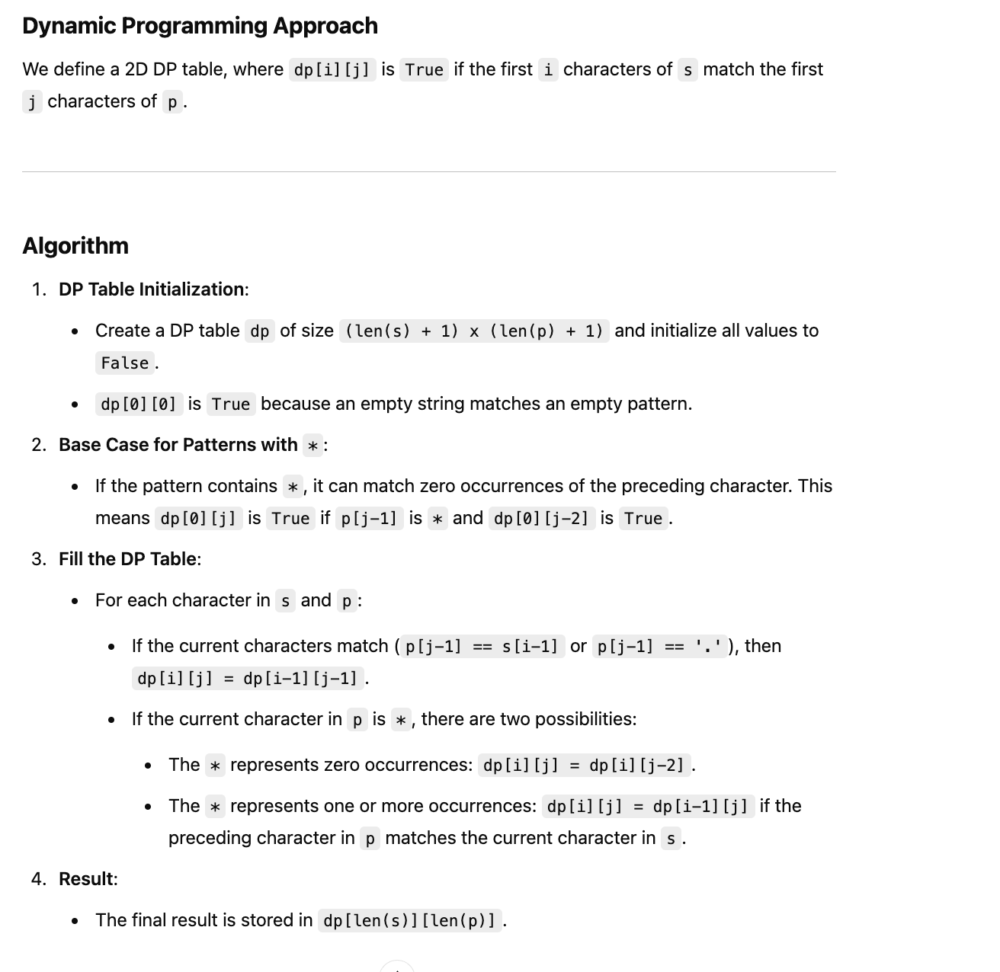

In [36]:
class Solution:
    def isMatch(self, s: str, p: str) -> bool:
        m, n = len(s), len(p)
        
        # Initialize the DP table
        dp = [[False] * (n + 1) for _ in range(m + 1)]
        
        # Base case: empty string matches empty pattern
        dp[0][0] = True
        
        # Handle patterns with '*' that match an empty string
        for j in range(2, n + 1):
            if p[j - 1] == '*':
                dp[0][j] = dp[0][j - 2]
        
        # Fill the DP table
        for i in range(1, m + 1):
            for j in range(1, n + 1):
                if p[j - 1] == s[i - 1] or p[j - 1] == '.':
                    # Characters match or '.' matches any character
                    dp[i][j] = dp[i - 1][j - 1]
                elif p[j - 1] == '*':
                    # '*' matches zero or more of the preceding character
                    dp[i][j] = dp[i][j - 2]  # Zero occurrences
                    if p[j - 2] == s[i - 1] or p[j - 2] == '.':
                        dp[i][j] = dp[i][j] or dp[i - 1][j]  # One or more occurrences

        # Final result
        return dp[m][n]


In [37]:
s = "aab"
p = "c*a*b"
solution = Solution()
print(solution.isMatch(s, p))  # Output: True

True


************************************************************************************************************************************************************************************************************

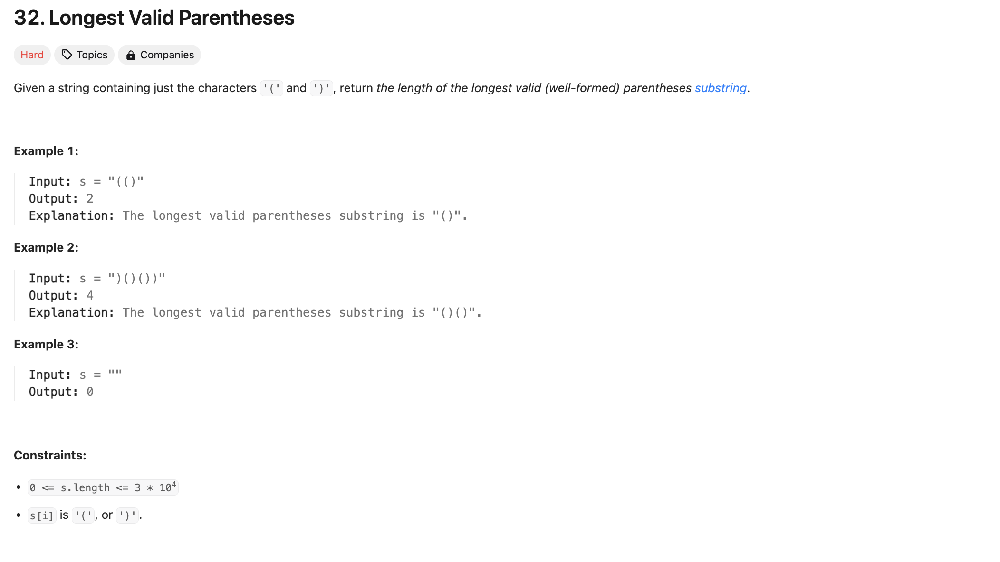

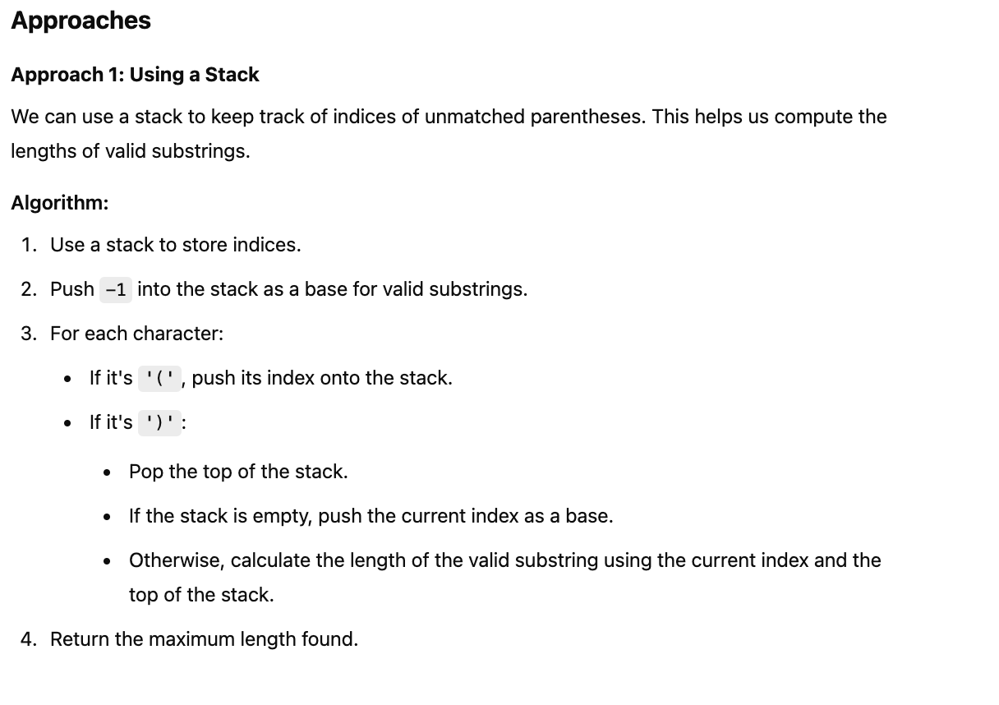

In [38]:
class Solution:
    def longestValidParentheses(self, s: str) -> int:
        stack = [-1]  # Initialize stack with a base index
        max_length = 0
        
        for i, char in enumerate(s):
            if char == '(':
                stack.append(i)  # Push the index of '(' onto the stack
            else:
                stack.pop()  # Pop the top of the stack
                if not stack:
                    stack.append(i)  # If the stack is empty, push the current index
                else:
                    # Calculate the length of the valid substring
                    max_length = max(max_length, i - stack[-1])
        
        return max_length


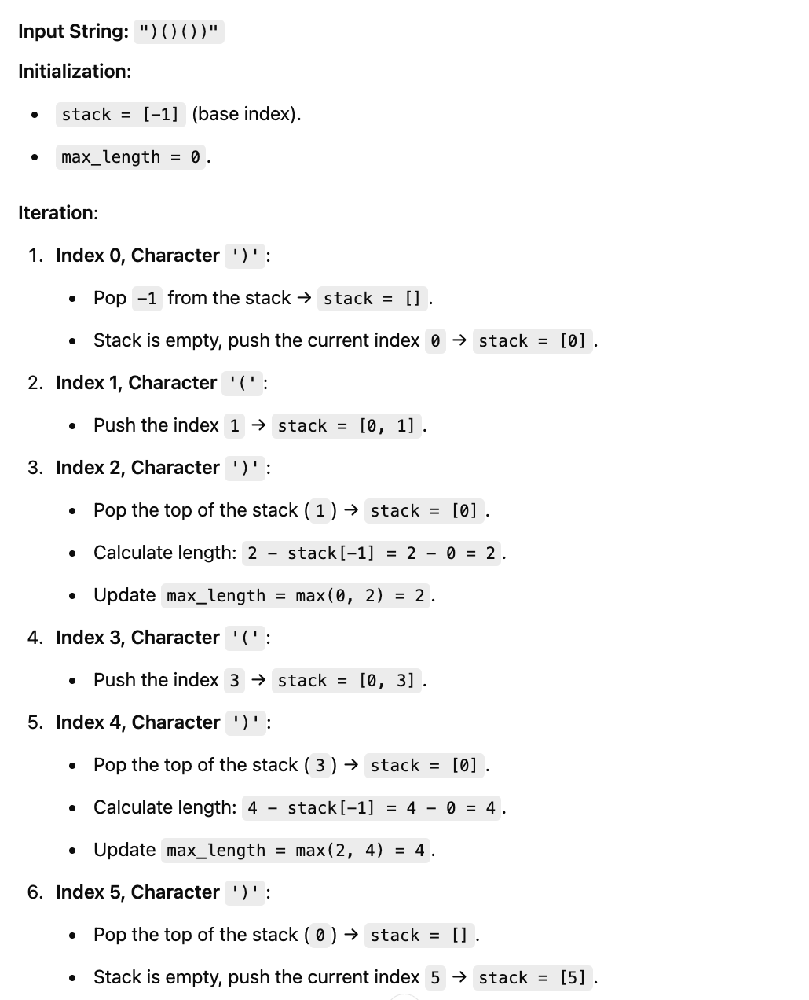

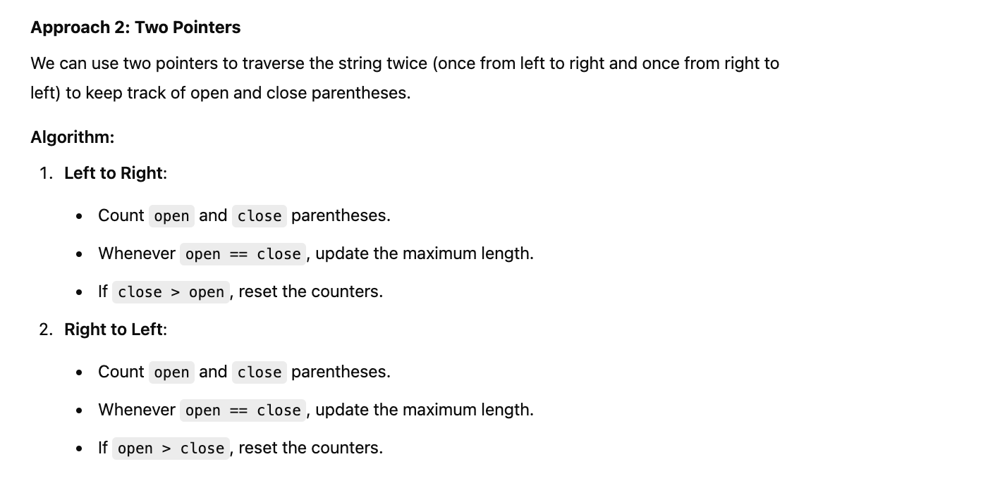

In [39]:
class Solution:
    def longestValidParentheses(self, s: str) -> int:
        max_length = 0
        open_count, close_count = 0, 0
        
        # Left to right
        for char in s:
            if char == '(':
                open_count += 1
            else:
                close_count += 1
            if open_count == close_count:
                max_length = max(max_length, 2 * close_count)
            elif close_count > open_count:
                open_count = close_count = 0
        
        # Reset counters for right to left
        open_count, close_count = 0, 0
        
        # Right to left
        for char in reversed(s):
            if char == '(':
                open_count += 1
            else:
                close_count += 1
            if open_count == close_count:
                max_length = max(max_length, 2 * open_count)
            elif open_count > close_count:
                open_count = close_count = 0
        
        return max_length


In [42]:
s = "(())()())"
solution = Solution()
print(solution.longestValidParentheses(s))  # Output: 4


8


************************************************************************************************************************************************************************************************************

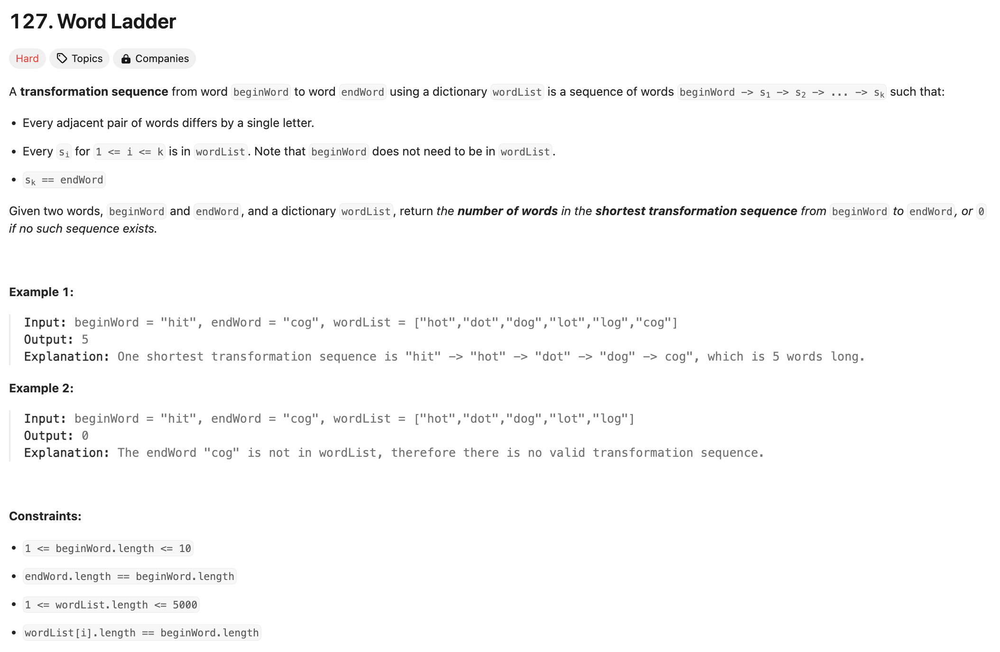

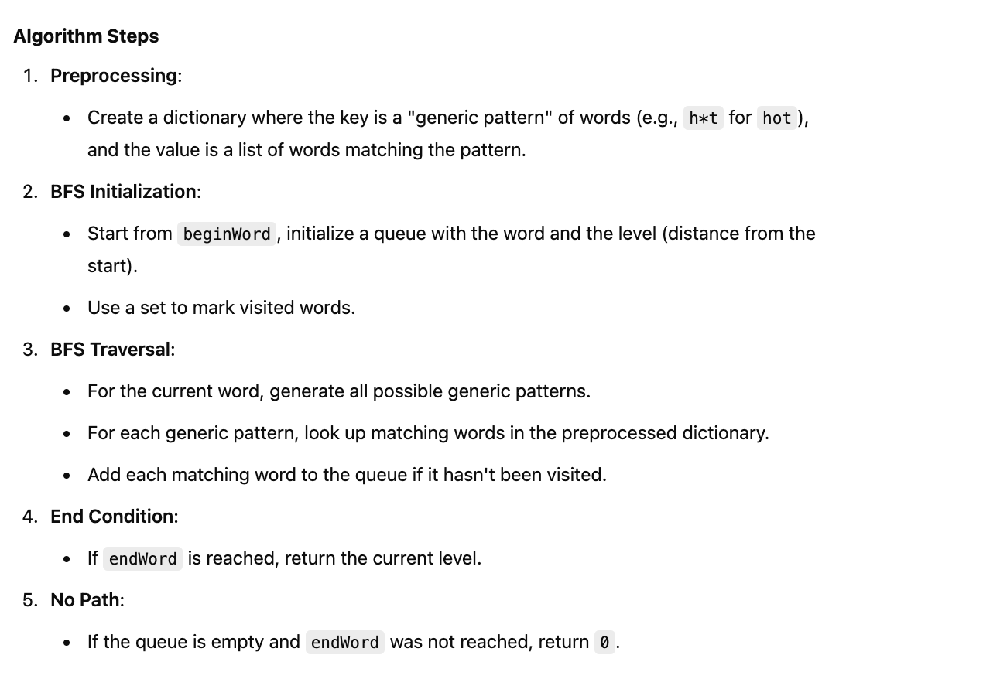

In [43]:
from collections import deque, defaultdict

class Solution:
    def ladderLength(self, beginWord: str, endWord: str, wordList: list[str]) -> int:
        if endWord not in wordList:
            return 0

        # Preprocess wordList into a generic pattern dictionary
        wordList = set(wordList)  # Convert to set for faster lookup
        pattern_dict = defaultdict(list)
        
        for word in wordList:
            for i in range(len(word)):
                pattern = word[:i] + '*' + word[i+1:]
                pattern_dict[pattern].append(word)
        
        # BFS initialization
        queue = deque([(beginWord, 1)])  # (current_word, level)
        visited = set()  # Keep track of visited words
        visited.add(beginWord)

        while queue:
            current_word, level = queue.popleft()
            
            # Generate generic patterns for the current word
            for i in range(len(current_word)):
                pattern = current_word[:i] + '*' + current_word[i+1:]
                
                # Process all neighbors
                for neighbor in pattern_dict[pattern]:
                    if neighbor == endWord:
                        return level + 1
                    
                    if neighbor not in visited:
                        visited.add(neighbor)
                        queue.append((neighbor, level + 1))
                
                # Clear the processed pattern to reduce future lookups
                pattern_dict[pattern] = []
        
        return 0


In [44]:
beginWord = "hit"
endWord = "cog"
wordList = ["hot", "dot", "dog", "lot", "log", "cog"]

solution = Solution()
print(solution.ladderLength(beginWord, endWord, wordList))  # Output: 5


5


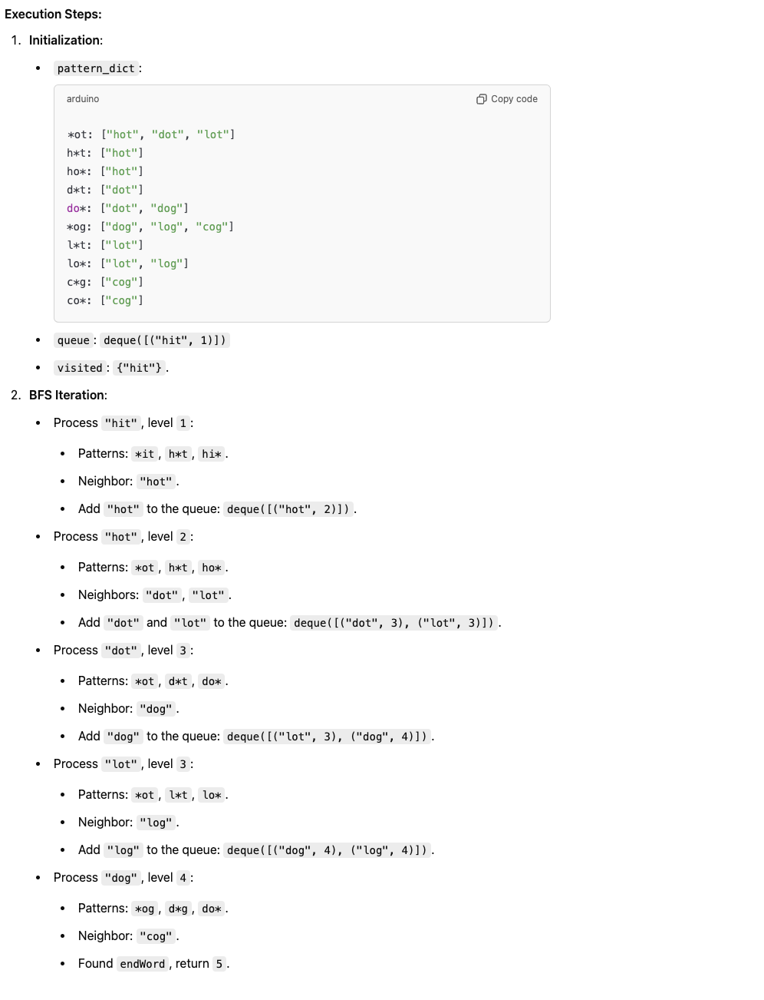

************************************************************************************************************************************************************************************************************

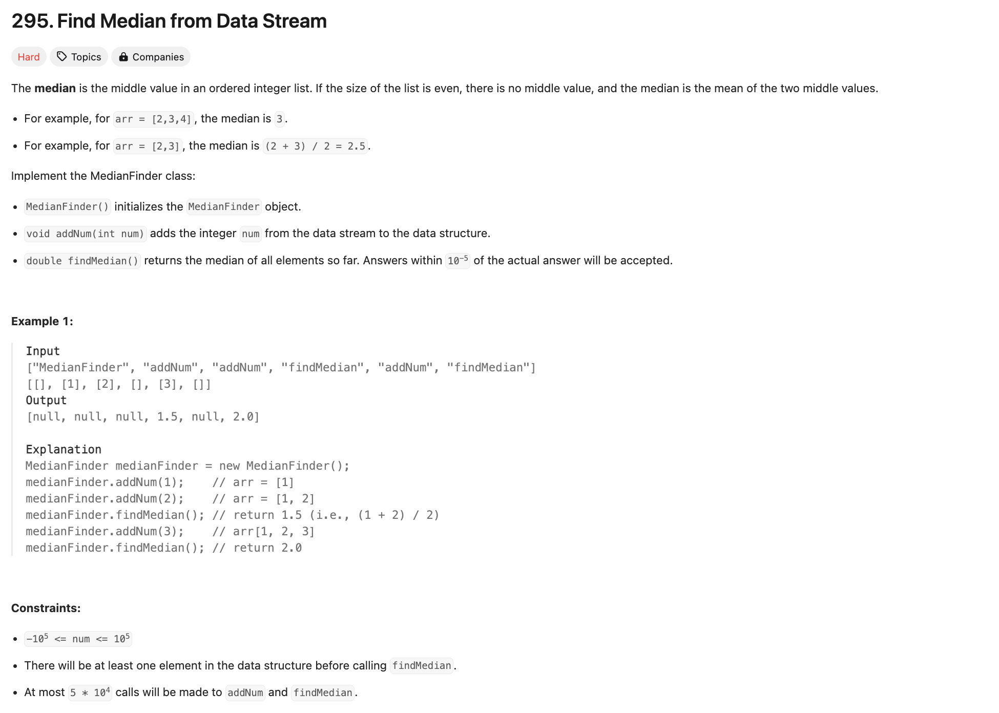

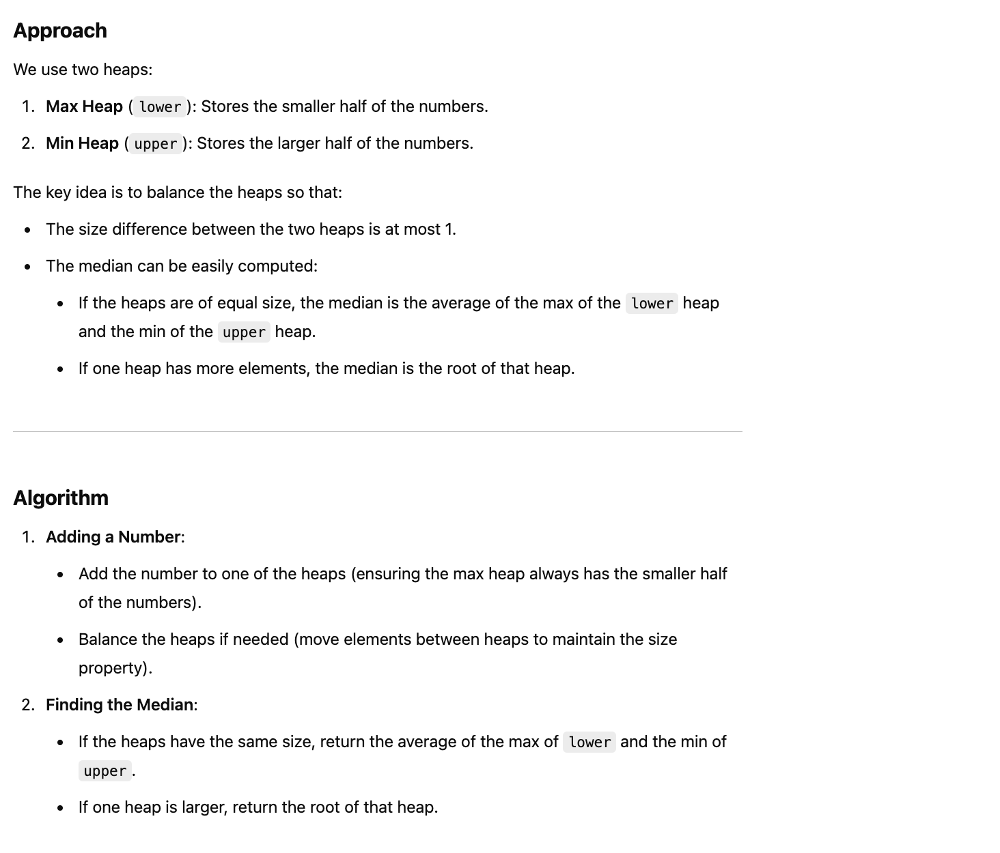

In [1]:
import heapq

class MedianFinder:
    def __init__(self):
        # Max heap for the lower half (invert sign for max heap behavior)
        self.lower = []
        # Min heap for the upper half
        self.upper = []

    def addNum(self, num: int) -> None:
        # Add to max heap (invert sign to simulate max heap)
        heapq.heappush(self.lower, -num)
        
        # Ensure every number in `lower` is <= every number in `upper`
        if self.lower and self.upper and (-self.lower[0] > self.upper[0]):
            heapq.heappush(self.upper, -heapq.heappop(self.lower))

        # Balance the heaps so that the size difference is at most 1
        if len(self.lower) > len(self.upper) + 1:
            heapq.heappush(self.upper, -heapq.heappop(self.lower))
        elif len(self.upper) > len(self.lower):
            heapq.heappush(self.lower, -heapq.heappop(self.upper))

    def findMedian(self) -> float:
        # If heaps are of equal size, median is the average of the roots
        if len(self.lower) == len(self.upper):
            return (-self.lower[0] + self.upper[0]) / 2.0
        # Otherwise, median is the root of the larger heap
        return -self.lower[0] if len(self.lower) > len(self.upper) else self.upper[0]


In [2]:
medianFinder = MedianFinder()
medianFinder.addNum(1)
medianFinder.addNum(2)
print(medianFinder.findMedian())  # Output: 1.5
medianFinder.addNum(3)
print(medianFinder.findMedian())  # Output: 2


1.5
2


************************************************************************************************************************************************************************************************************

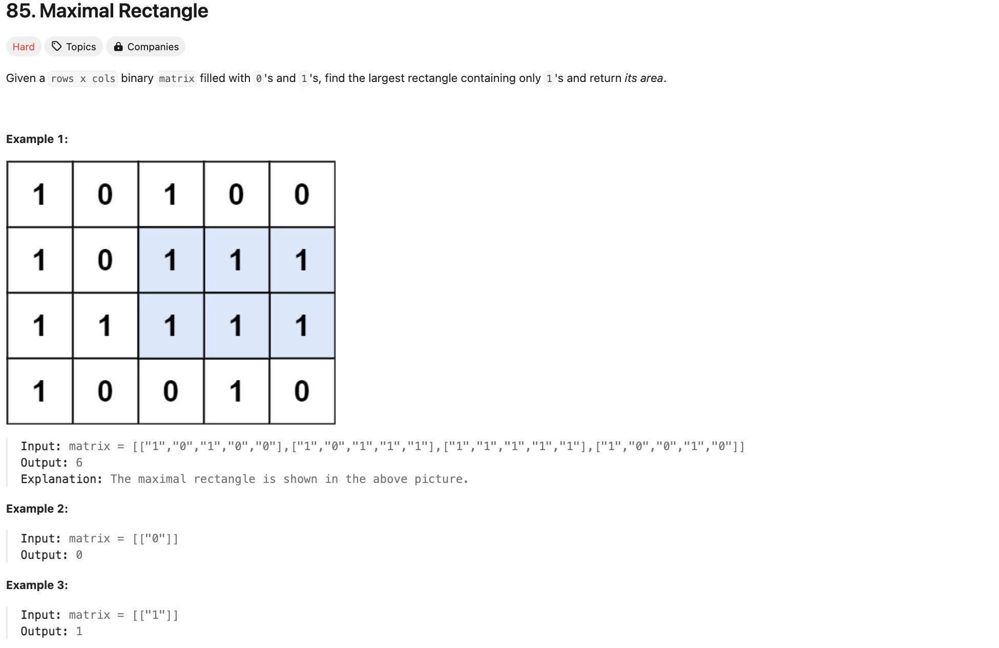

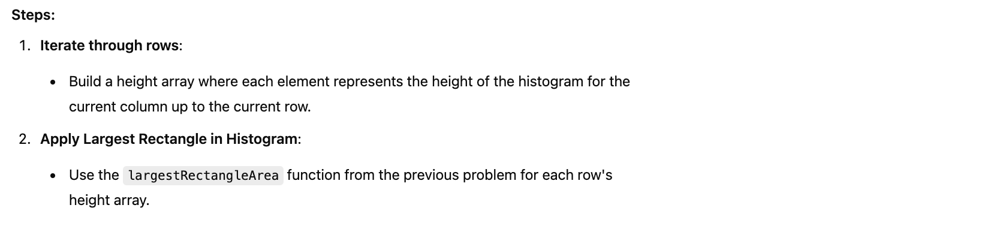

In [4]:
from typing import List
class Solution:
    def maximalRectangle(self, matrix: List[List[str]]) -> int:
        if not matrix or not matrix[0]:
            return 0  # Handle empty matrix case

        # Initialize variables
        rows, cols = len(matrix), len(matrix[0])
        heights = [0] * cols
        max_area = 0

        # Iterate through each row in the matrix
        for row in matrix:
            # Update the heights array based on the current row
            for col in range(cols):
                if row[col] == "1":
                    heights[col] += 1  # Increment height
                else:
                    heights[col] = 0  # Reset height
            
            # Calculate the largest rectangle area for the current histogram
            max_area = max(max_area, self.largestRectangleArea(heights))
        
        return max_area

    def largestRectangleArea(self, heights: List[int]) -> int:
        # Monotonic stack approach for Largest Rectangle in Histogram
        stack = []
        max_area = 0

        for i, h in enumerate(heights):
            start = i
            while stack and stack[-1][1] > h:
                index, height = stack.pop()
                max_area = max(max_area, height * (i - index))
                start = index
            stack.append((start, h))

        for i, h in stack:
            max_area = max(max_area, h * (len(heights) - i))

        return max_area


In [8]:
matrix = [
    ["1", "0", "1", "0", "0"],
    ["1", "0", "1", "1", "1"],
    ["1", "1", "1", "1", "1"],
    ["1", "0", "0", "1", "0"]
]
Solution().maximalRectangle(matrix)

6

************************************************************************************************************************************************************************************************************

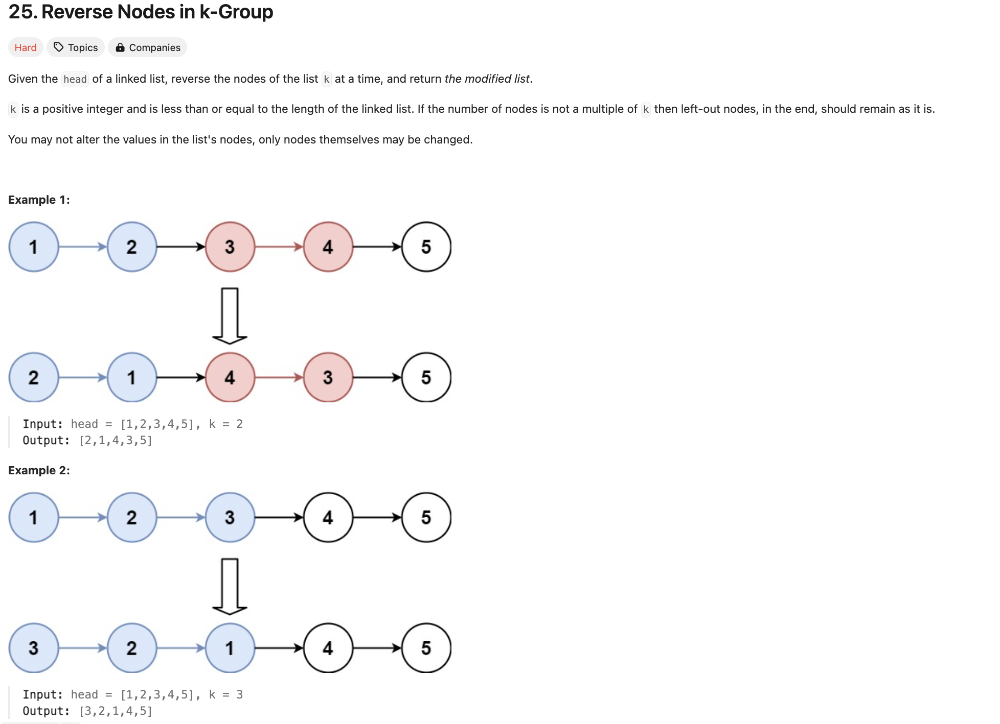

In [12]:
from typing import Optional

class ListNode:
    def __init__(self, val=0, next=None):
        self.val = val
        self.next = next
        
class Solution:
    def reverseKGroup(self, head: Optional[ListNode], k: int) -> Optional[ListNode]:
        dummyNode = ListNode(0, head)  # Dummy node pointing to the head of the list
        groupPrev = dummyNode

        while True:
            # Find the kth node from the current position
            kth = self.getkth(groupPrev, k)
            if not kth:  # If there are fewer than k nodes left, stop
                break

            groupNext = kth.next  # Node after the kth node

            # Reverse the group of k nodes
            prev, curr = groupNext, groupPrev.next
            while curr != groupNext:
                temp = curr.next
                curr.next = prev
                prev = curr
                curr = temp

            # Update pointers to connect reversed group
            temp = groupPrev.next
            groupPrev.next = kth
            groupPrev = temp  # Move groupPrev to the end of the reversed group

        return dummyNode.next

    def getkth(self, curr, k):
        # Find the kth node from the current position
        while curr and k > 0:
            curr = curr.next
            k -= 1
        return curr


In [20]:
# Helper function to create a linked list from a list of values
def create_linked_list(values):
    dummy = ListNode()
    curr = dummy
    for val in values:
        curr.next = ListNode(val)
        curr = curr.next
    return dummy.next

# Helper function to print a linked list
def print_linked_list(head):
    vals = []
    while head:
        vals.append(head.val)
        head = head.next
    print(" -> ".join(map(str, vals)))

# Example
solution = Solution()
head = create_linked_list([1, 2, 3, 4, 5,8,9,10])
k = 3
new_head = solution.reverseKGroup(head, k)
print_linked_list(new_head)

3 -> 2 -> 1 -> 8 -> 5 -> 4 -> 9 -> 10


************************************************************************************************************************************************************************************************************

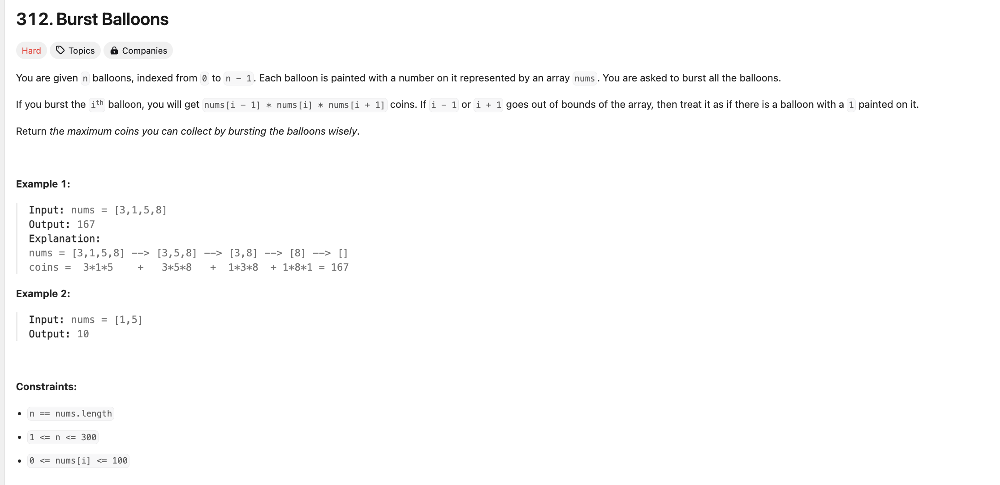

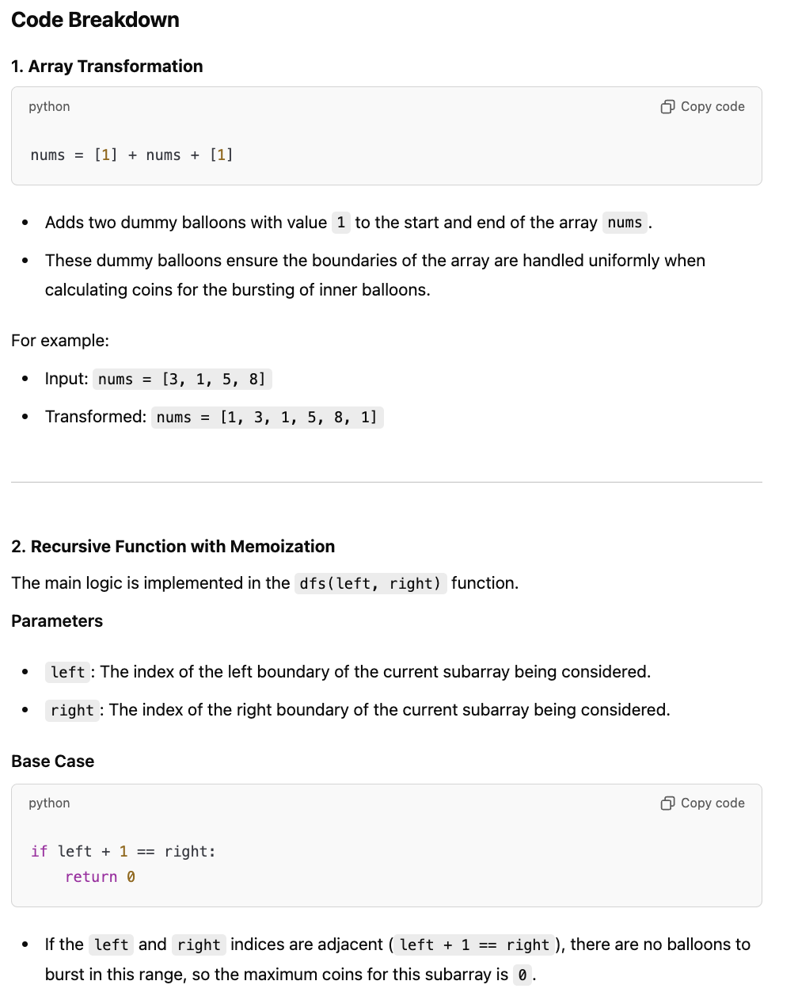

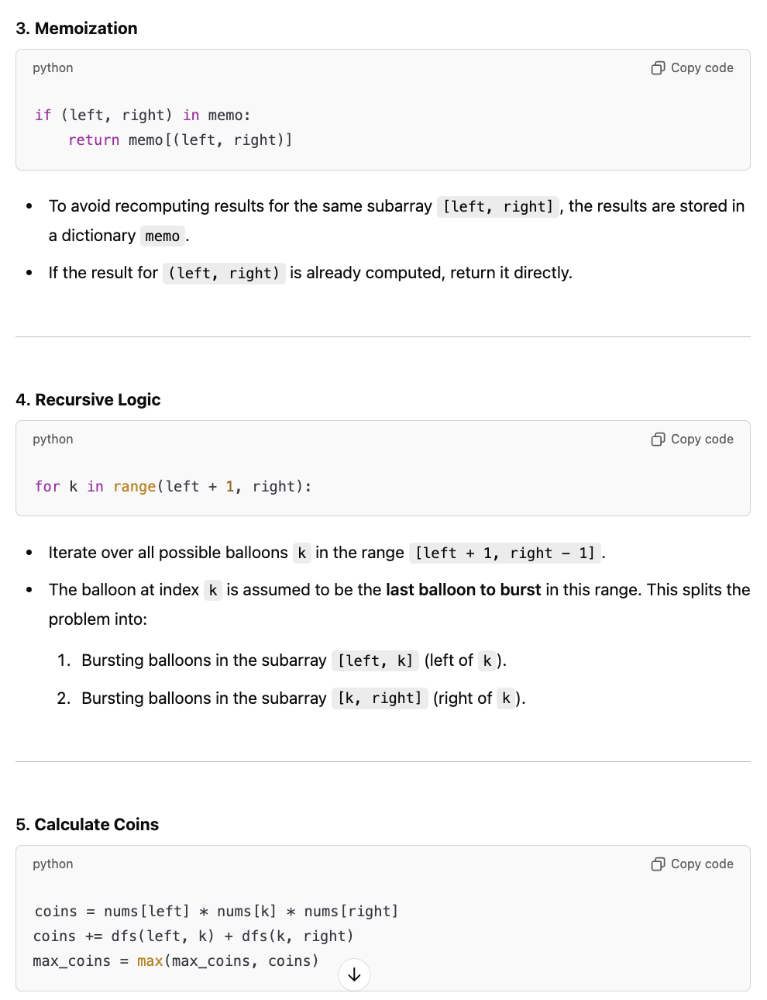

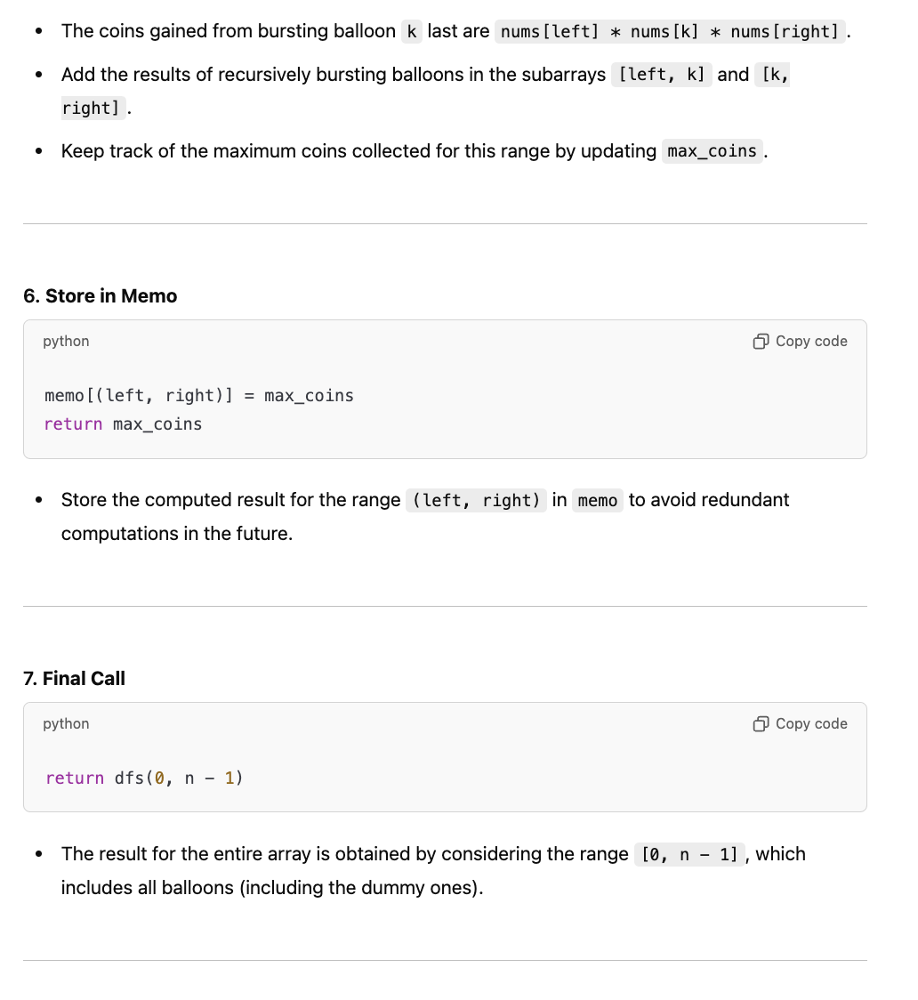

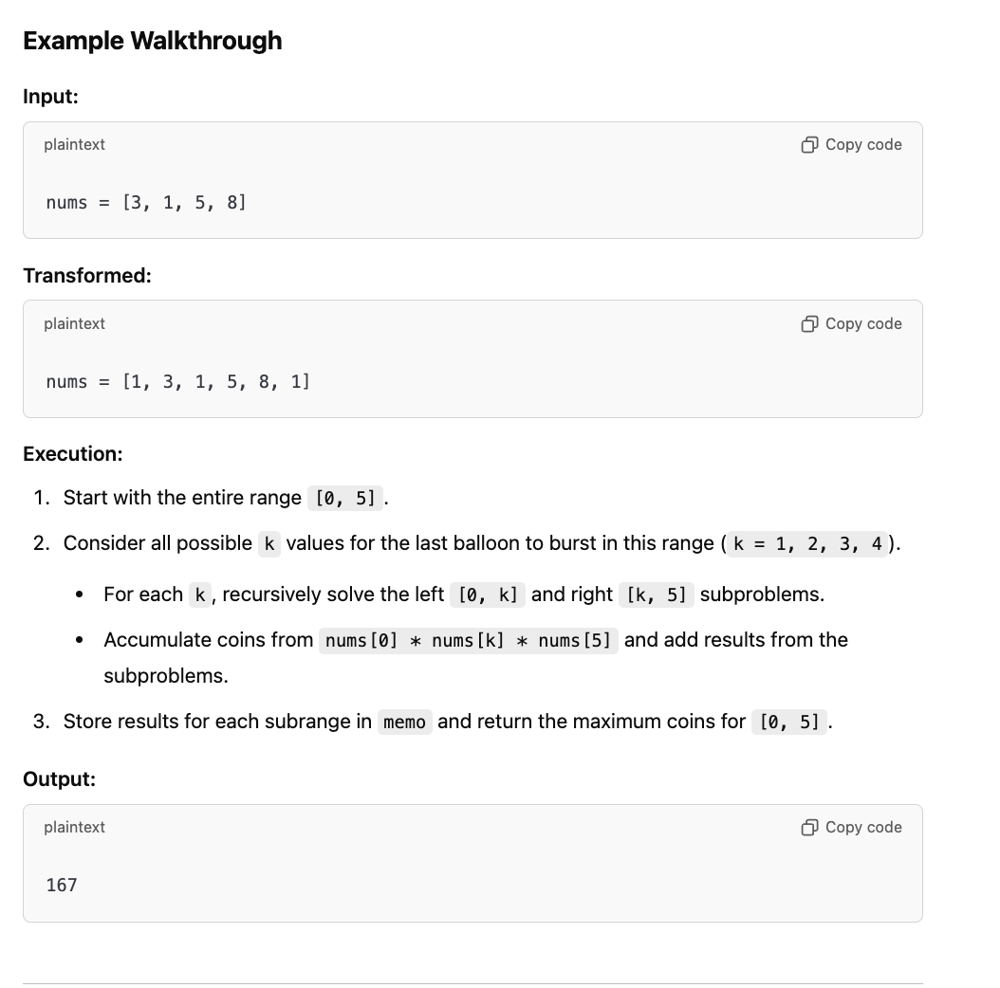

In [4]:
from typing import List
class Solution:
    def maxCoins(self, nums: List[int]) -> int:
        nums = [1] + nums + [1]
        n = len(nums)
        memo = {}

        def dfs(left, right):
            if left + 1 == right:
                return 0
            if (left, right) in memo:
                return memo[(left, right)]
            
            max_coins = 0
            for k in range(left + 1, right):
                coins = nums[left] * nums[k] * nums[right]
                coins += dfs(left, k) + dfs(k, right)
                max_coins = max(max_coins, coins)
            
            memo[(left, right)] = max_coins
            return max_coins

        return dfs(0, n - 1)


In [5]:
nums = [3,1,5,8]
Solution().maxCoins(nums)


167

************************************************************************************************************************************************************************************************************

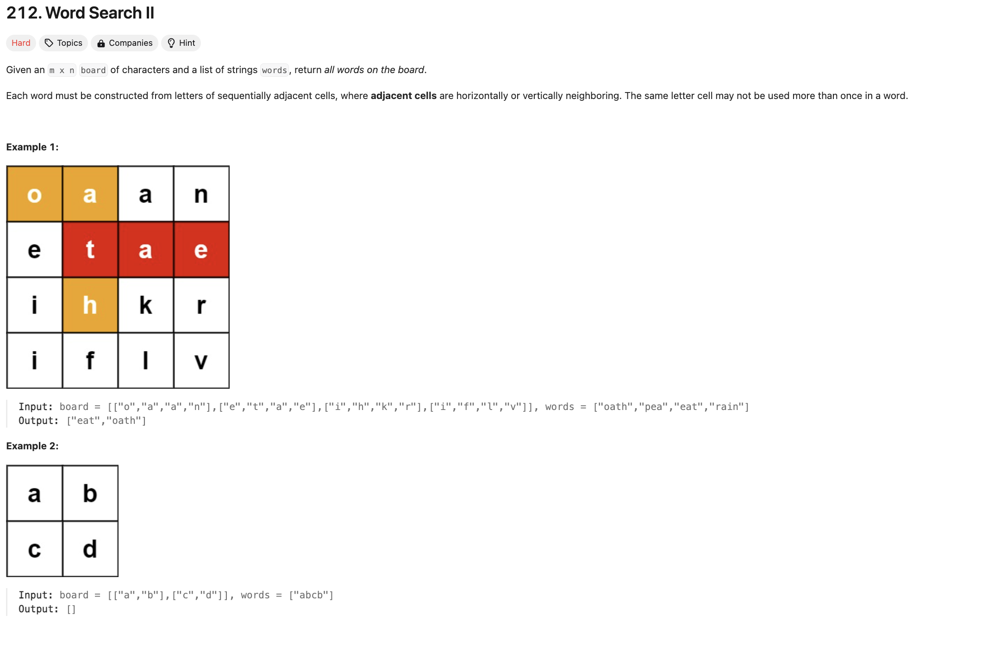

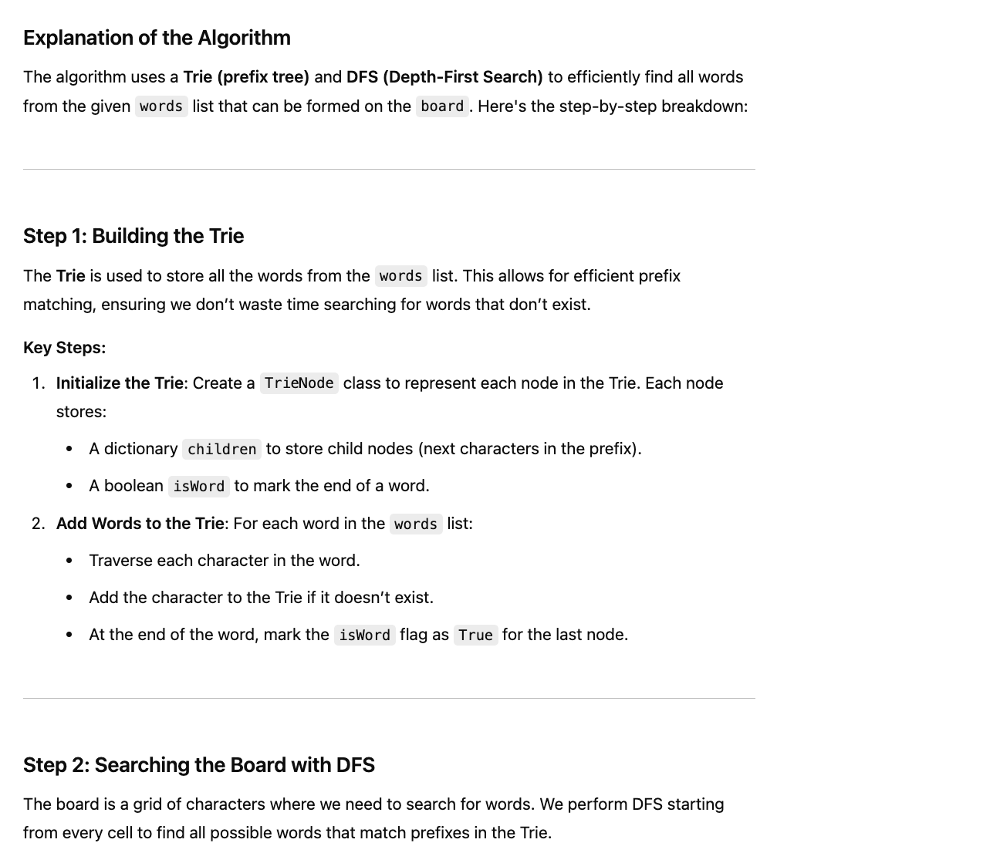

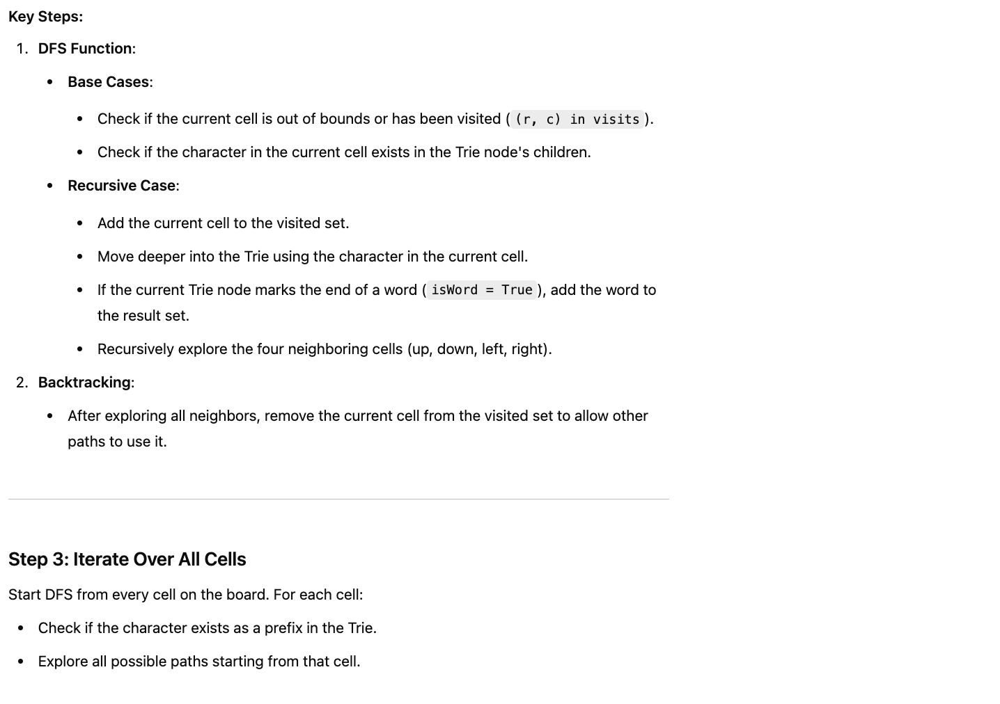

In [6]:
from typing import List

class TrieNode:
    def __init__(self):
        self.children = {}
        self.isWord = False

    def addNode(self, word):
        curr = self
        for c in word:
            if c not in curr.children:
                curr.children[c] = TrieNode()
            curr = curr.children[c]
        curr.isWord = True  # Mark the end of the word


class Solution:
    def findWords(self, board: List[List[str]], words: List[str]) -> List[str]:
        # Build the Trie
        root = TrieNode()
        for w in words:
            root.addNode(w)

        ROW, COL = len(board), len(board[0])
        res, visits = set(), set()

        def dfs(r, c, node, word):
            # Base case: Check boundaries, visited cells, and character in Trie
            if (r < 0 or c < 0 or r >= ROW or c >= COL or
                    (r, c) in visits or board[r][c] not in node.children):
                return
            
            # Add the current cell to the visited set
            visits.add((r, c))
            # Move to the next Trie node
            node = node.children[board[r][c]]
            # Append the character to the current word
            word += board[r][c]

            # If this node represents the end of a word, add it to results
            if node.isWord:
                res.add(word)

            # Explore all four directions
            dfs(r - 1, c, node, word)
            dfs(r + 1, c, node, word)
            dfs(r, c - 1, node, word)
            dfs(r, c + 1, node, word)

            # Backtrack
            visits.remove((r, c))

        # Start DFS from each cell in the board
        for r in range(ROW):
            for c in range(COL):
                dfs(r, c, root, "")

        return list(res)


In [8]:
board = [
    ['o', 'a', 'a', 'n'],
    ['e', 't', 'a', 'e'],
    ['i', 'h', 'k', 'r'],
    ['i', 'f', 'l', 'v']
]
words = ["oath", "pea", "eat", "rain"]

solution = Solution()
print(solution.findWords(board, words))

['oath', 'eat']


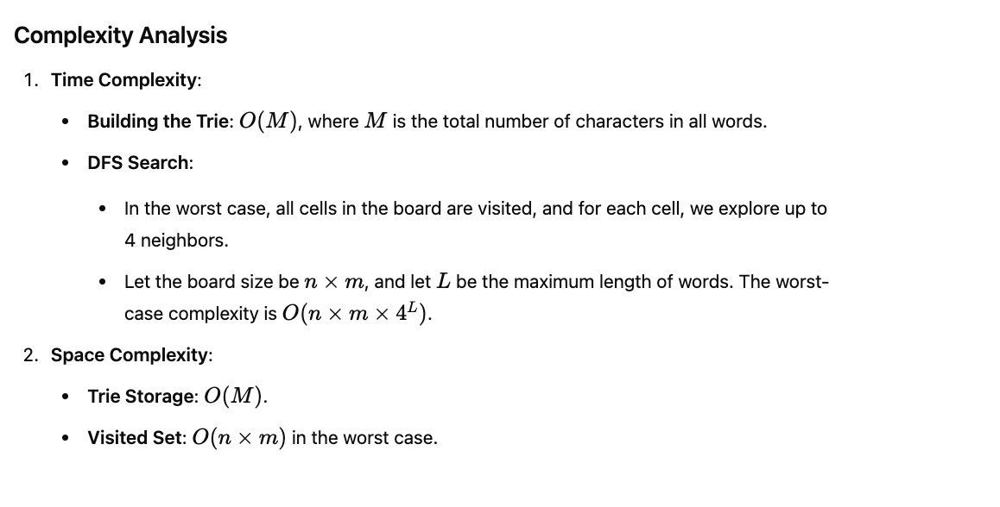

************************************************************************************************************************************************************************************************************

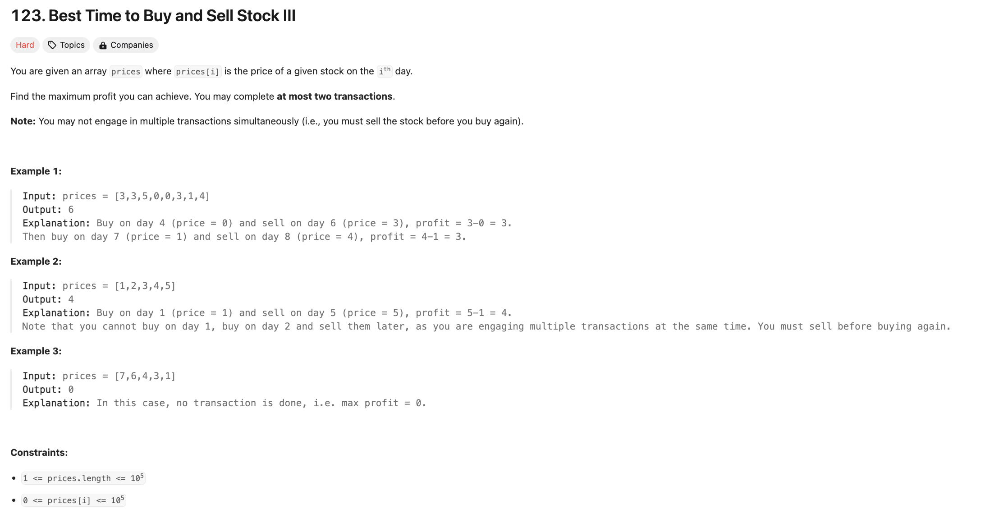

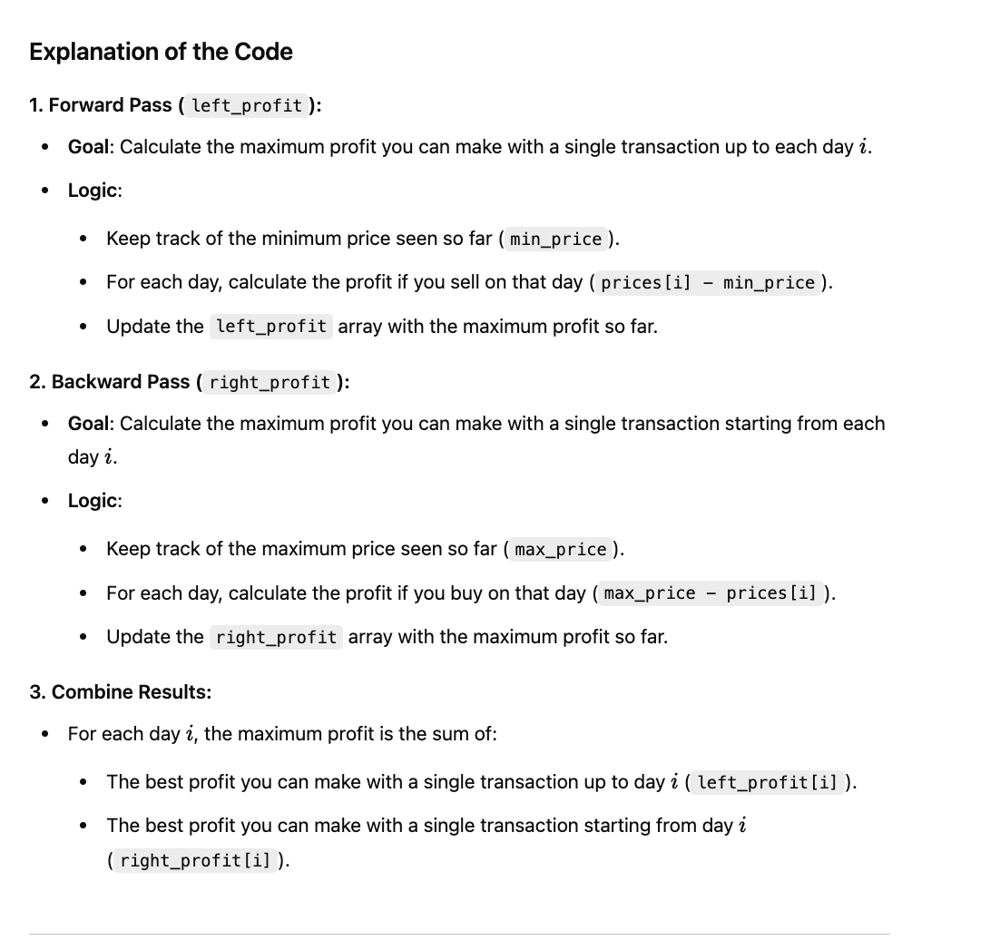

In [9]:
from typing import List

class Solution:
    def maxProfit(self, prices: List[int]) -> int:
        if not prices:
            return 0
        
        n = len(prices)
        
        # Forward pass: max profit with one transaction up to day i
        left_profit = [0] * n
        min_price = prices[0]
        for i in range(1, n):
            min_price = min(min_price, prices[i])  # Update the minimum price
            left_profit[i] = max(left_profit[i - 1], prices[i] - min_price)  # Max profit up to day i
        
        # Backward pass: max profit with one transaction from day i onward
        right_profit = [0] * n
        max_price = prices[-1]
        for i in range(n - 2, -1, -1):
            max_price = max(max_price, prices[i])  # Update the maximum price
            right_profit[i] = max(right_profit[i + 1], max_price - prices[i])  # Max profit from day i onward
        
        # Combine the results of the two passes
        max_profit = 0
        for i in range(n):
            max_profit = max(max_profit, left_profit[i] + right_profit[i])
        
        return max_profit


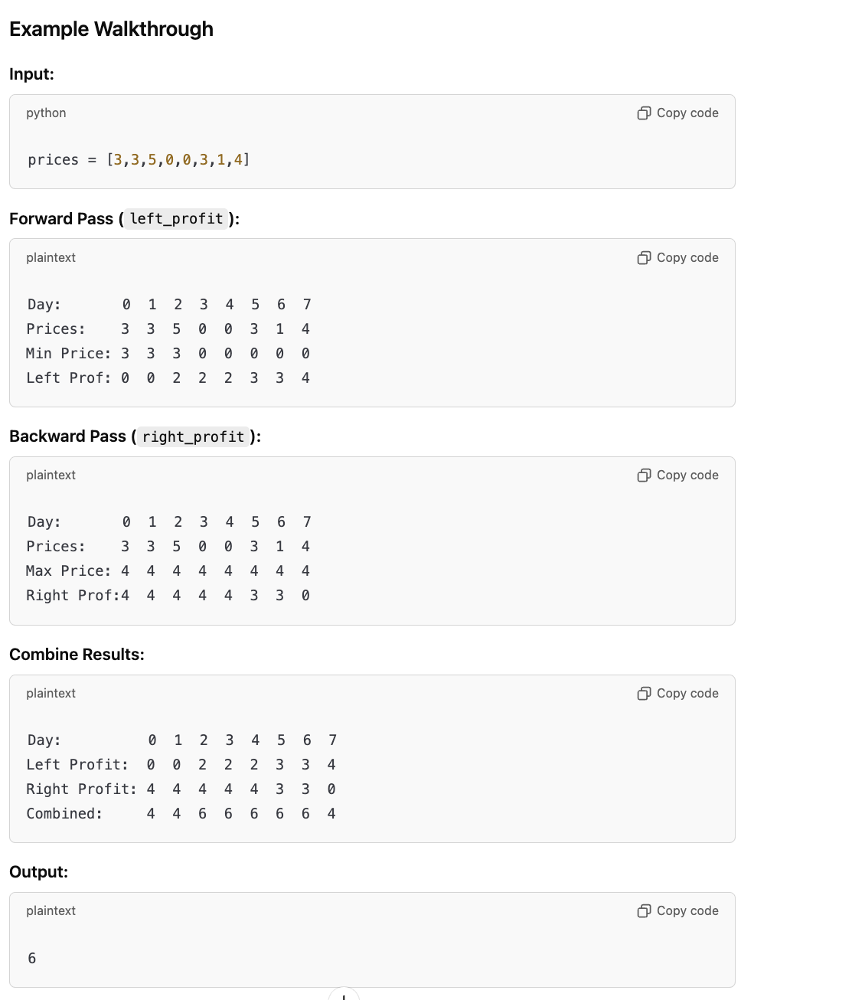

************************************************************************************************************************************************************************************************************

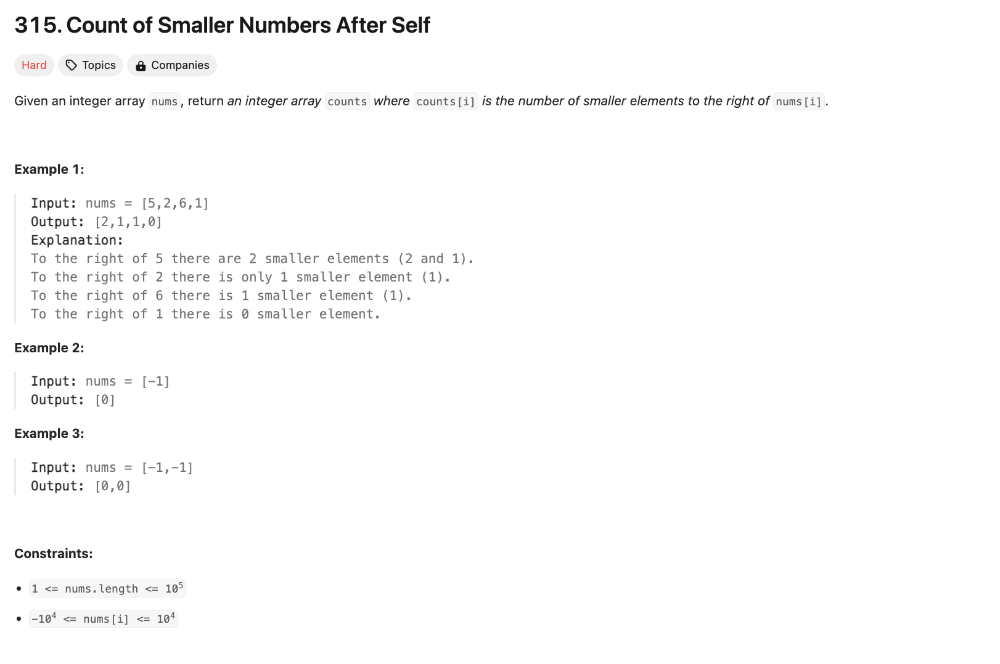

In [1]:
from typing import List

class Solution:
    def countSmaller(self, nums: List[int]) -> List[int]:
        # Step 1: Discretize the nums array
        sorted_nums = sorted(set(nums))
        rank_map = {num: i + 1 for i, num in enumerate(sorted_nums)}  # Rank starts from 1
        
        # Step 2: Initialize the Binary Indexed Tree (BIT)
        fenwick_tree = [0] * (len(sorted_nums) + 1)
        
        # Function to update the BIT
        def update(index, delta):
            while index < len(fenwick_tree):
                fenwick_tree[index] += delta
                index += index & -index
        
        # Function to query the BIT
        def query(index):
            result = 0
            while index > 0:
                result += fenwick_tree[index]
                index -= index & -index
            return result
        
        # Step 3: Process nums from right to left
        result = []
        for num in reversed(nums):
            rank = rank_map[num]  # Get the rank of the current number
            result.append(query(rank - 1))  # Count of smaller elements
            update(rank, 1)  # Add the current number's rank to the BIT
        
        return result[::-1]  # Reverse the result to match the original order


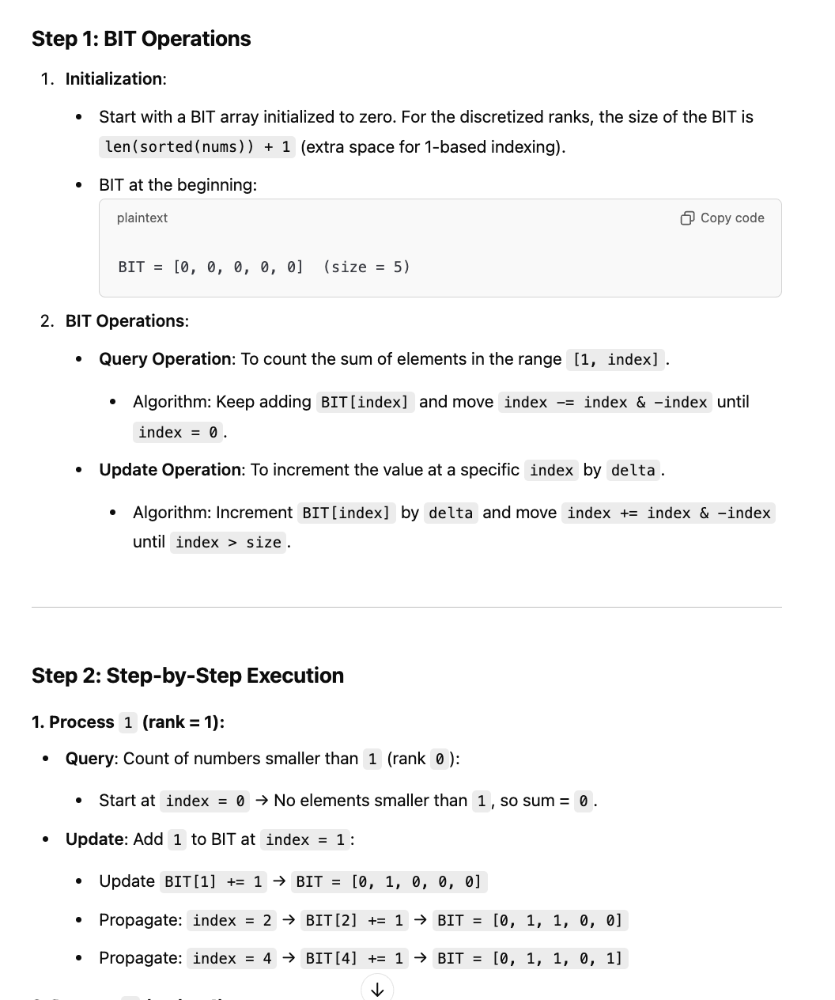

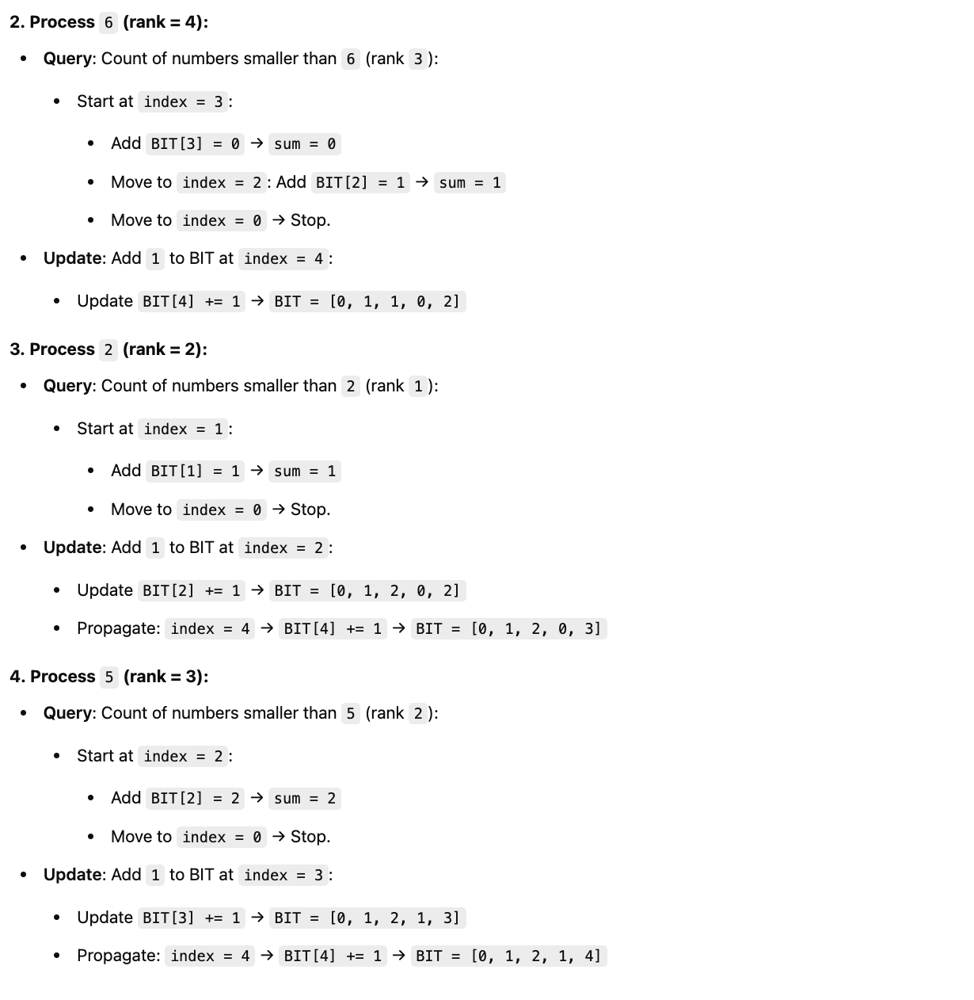

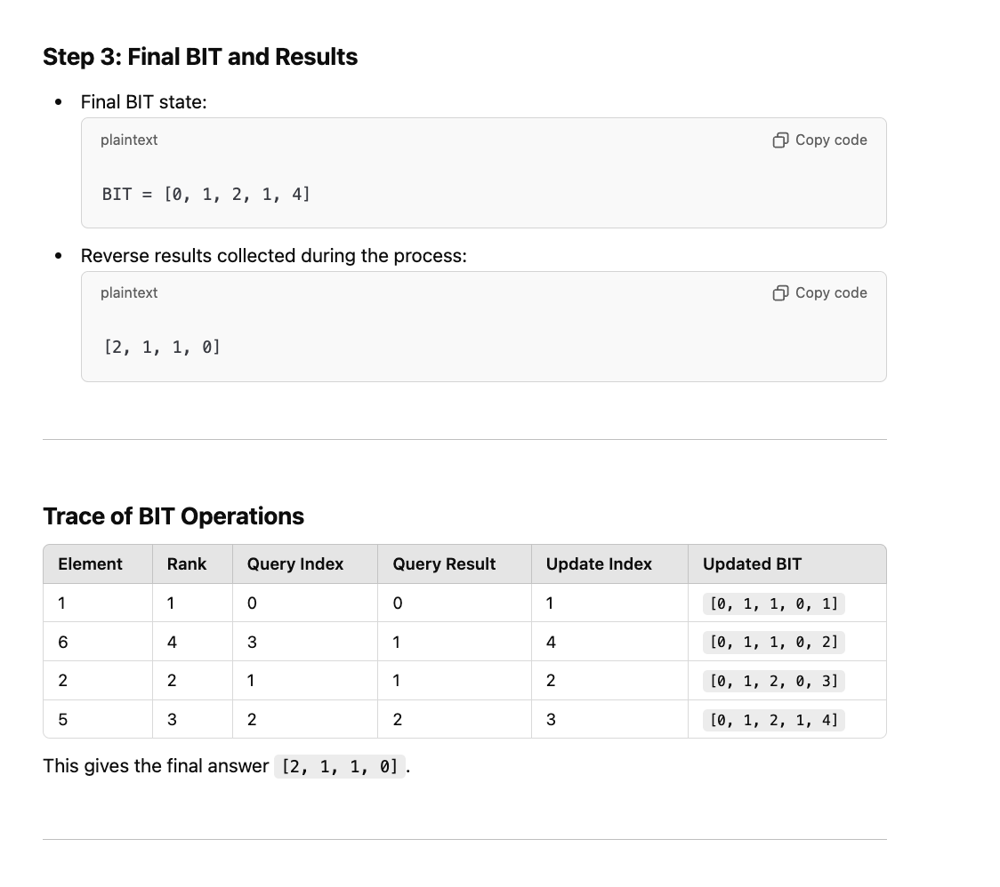

************************************************************************************************************************************************************************************************************


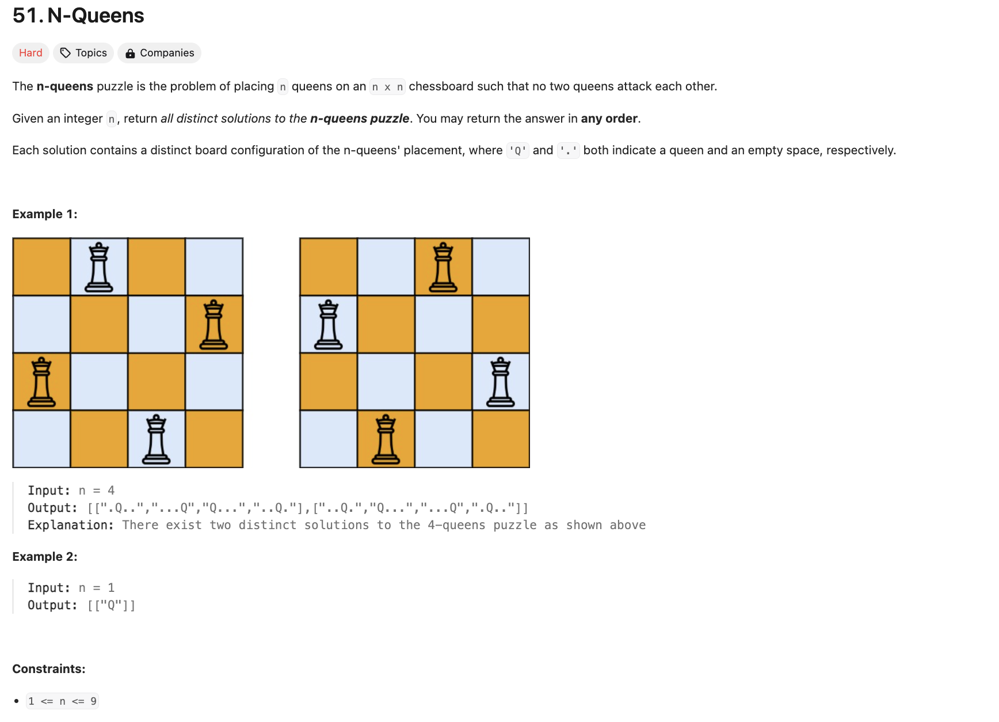

In [2]:
class Solution:
    def solveNQueens(self, n: int) -> List[List[str]]:
        if n <= 0:
            return []

        # Sets to track column and diagonal conflicts
        col = set()
        posDig = set()  # Positive diagonals (r + c)
        negDig = set()  # Negative diagonals (r - c)

        res = []  # List to store the final solutions
        board = [["."] * n for _ in range(n)]  # Initialize the chessboard

        def backtracking(r):
            # Base case: all queens are placed
            if r == n:
                # Create a copy of the current board and add to results
                copy = ["".join(row) for row in board]
                res.append(copy)
                return

            # Try placing a queen in each column of row `r`
            for c in range(n):
                if c in col or (r - c) in negDig or (r + c) in posDig:
                    continue

                # Place queen and mark conflicts
                col.add(c)
                posDig.add(r + c)
                negDig.add(r - c)
                board[r][c] = "Q"

                # Recur to place queens in the next row
                backtracking(r + 1)

                # Backtrack: remove the queen and unmark conflicts
                col.remove(c)
                posDig.remove(r + c)
                negDig.remove(r - c)
                board[r][c] = "."

        backtracking(0)
        return res


In [3]:
n = 4
solution = Solution()
print(solution.solveNQueens(n))

[['.Q..', '...Q', 'Q...', '..Q.'], ['..Q.', 'Q...', '...Q', '.Q..']]


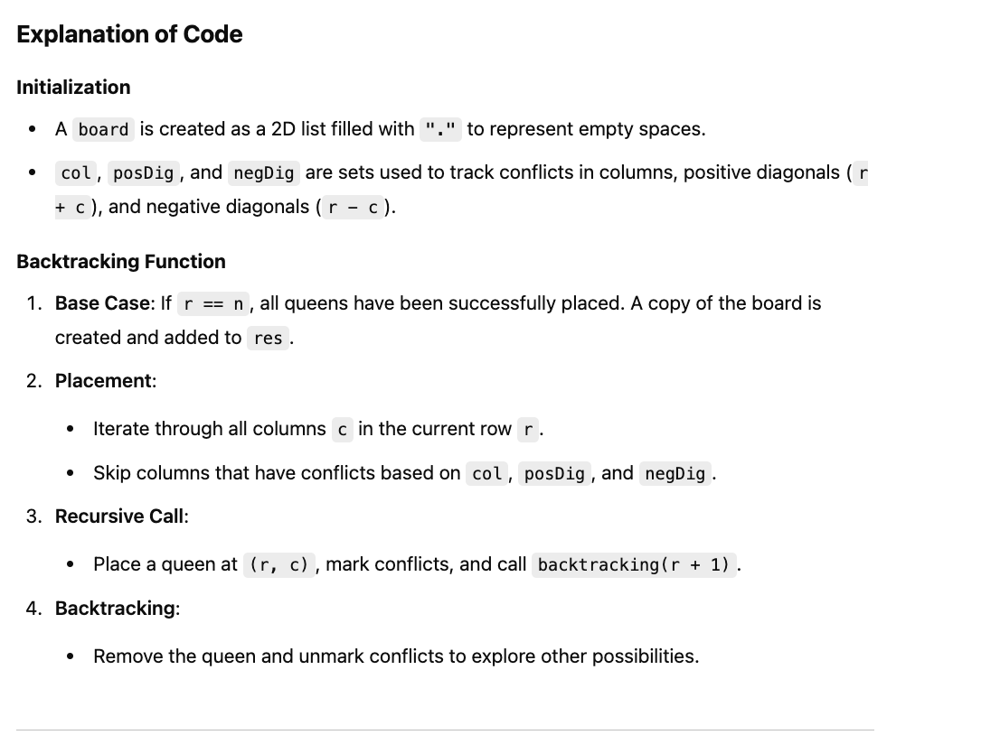

************************************************************************************************************************************************************************************************************

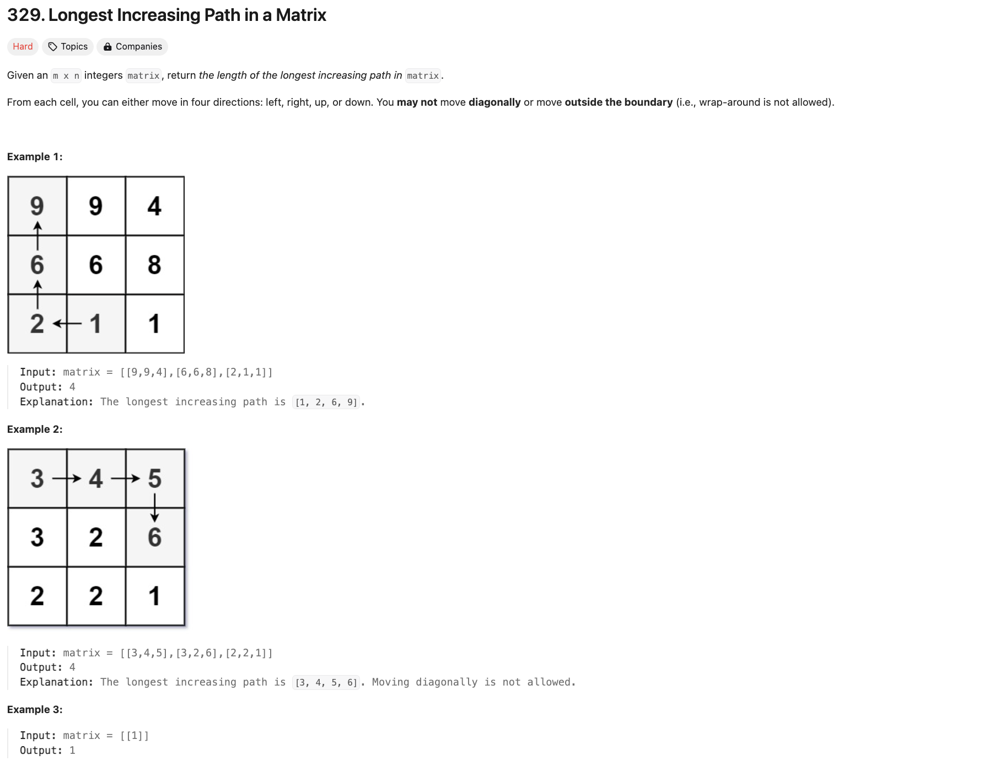

In [4]:
class Solution:
    def longestIncreasingPath(self, matrix: List[List[int]]) -> int:
        # Step 1: Initialize necessary variables
        row = len(matrix)  # Number of rows in the matrix
        col = len(matrix[0])  # Number of columns in the matrix
        dp = {}  # Dictionary for memoization (to store previously calculated results)

        # Step 2: Define the DFS function for depth-first search with memoization
        def dfs(r, c, preVal):
            # Base Case: If the current cell is out of bounds or the value is not greater than preVal
            # we return 0, which means no valid path is possible from this cell
            if r < 0 or r == row or c < 0 or c == col or matrix[r][c] <= preVal:
                return 0  # Return 0 since we cannot move to this cell in an increasing path

            # If the current position (r, c) has already been visited and stored in dp, return the stored result
            if (r, c) in dp:
                return dp[(r, c)]  # Return the memoized result for this cell

            # Step 3: Initialize the result for the current cell
            res = 1  # At least the current cell itself is part of the path, so start with length 1

            # Step 4: Explore all four directions (down, up, left, right) to find the longest increasing path
            # For each direction, recursively call dfs, adding 1 to the result
            res = max(res, 1 + dfs(r + 1, c, matrix[r][c]))  # Move down
            res = max(res, 1 + dfs(r - 1, c, matrix[r][c]))  # Move up
            res = max(res, 1 + dfs(r, c - 1, matrix[r][c]))  # Move left
            res = max(res, 1 + dfs(r, c + 1, matrix[r][c]))  # Move right

            # Step 5: Memoize the result for the current cell to avoid redundant calculations
            dp[(r, c)] = res  # Store the computed result in the dp dictionary

            return res  # Return the longest increasing path length from this cell

        # Step 6: Iterate over all cells in the matrix and compute the longest increasing path starting from each cell
        for r in range(row):  # Loop over each row
            for c in range(col):  # Loop over each column
                dfs(r, c, -1)  # Call dfs for the current cell (start with -1 as preVal)

        # Step 7: The final result will be the maximum of all the computed paths in the dp dictionary
        return max(dp.values())  # Return the maximum value found in the dp dictionary (longest path)


In [6]:
matrix = [
    [9, 9, 4],
    [6, 6, 8],
    [2, 1, 0]
]

solution = Solution()
print(solution.longestIncreasingPath(matrix))  # Output: 4

5


************************************************************************************************************************************************************************************************************


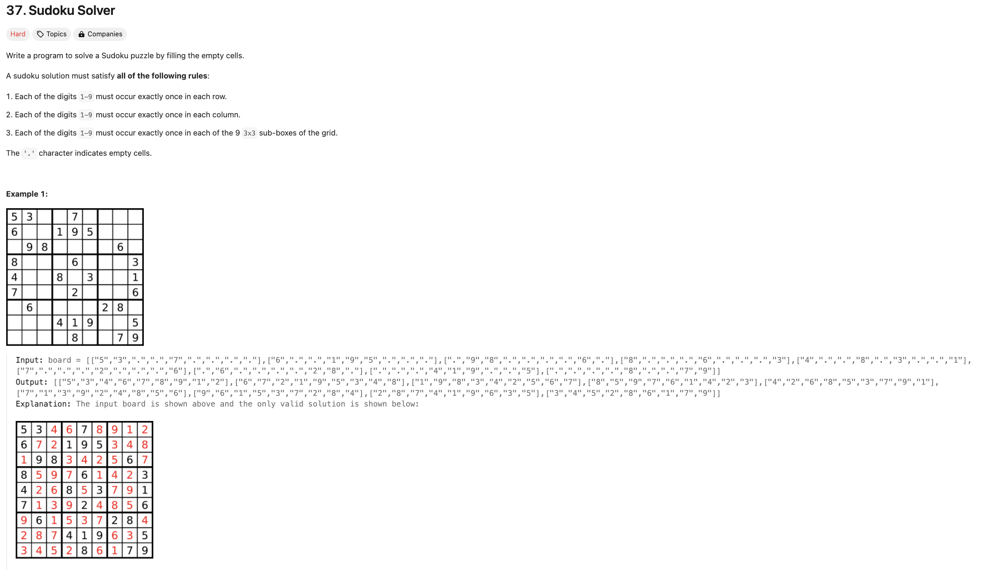

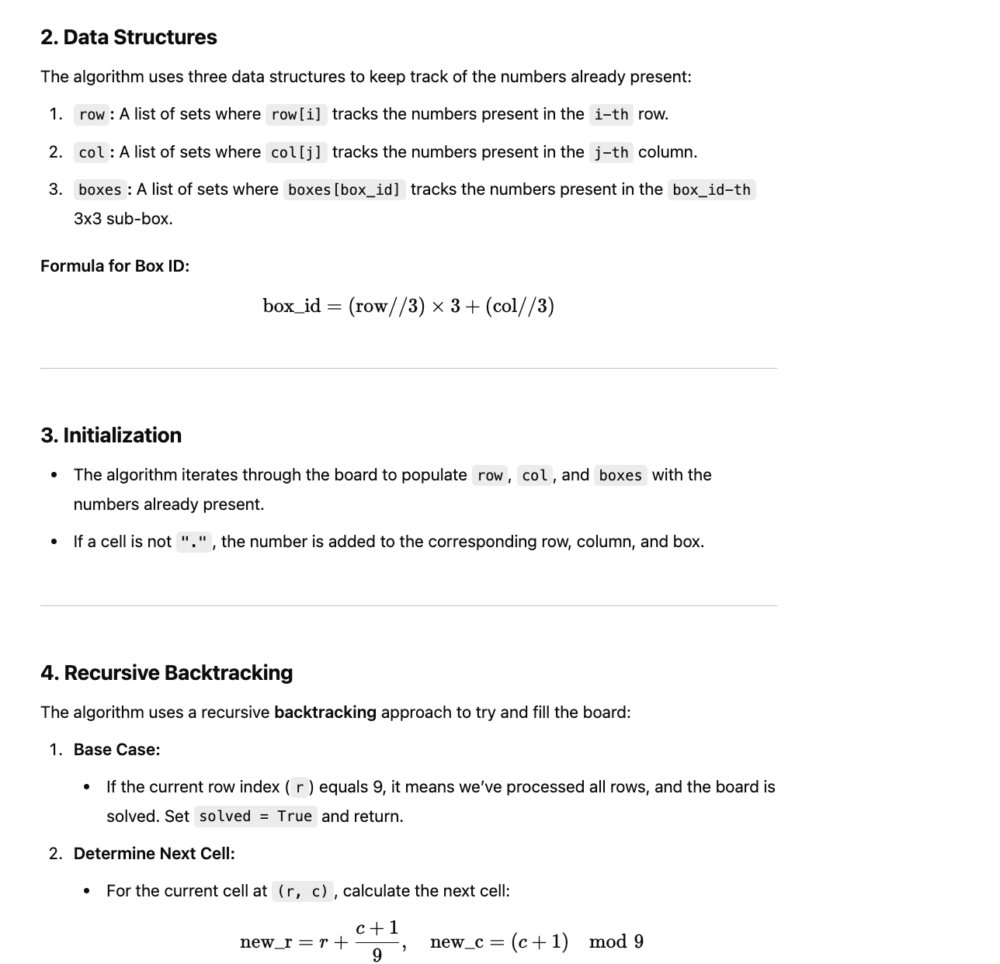

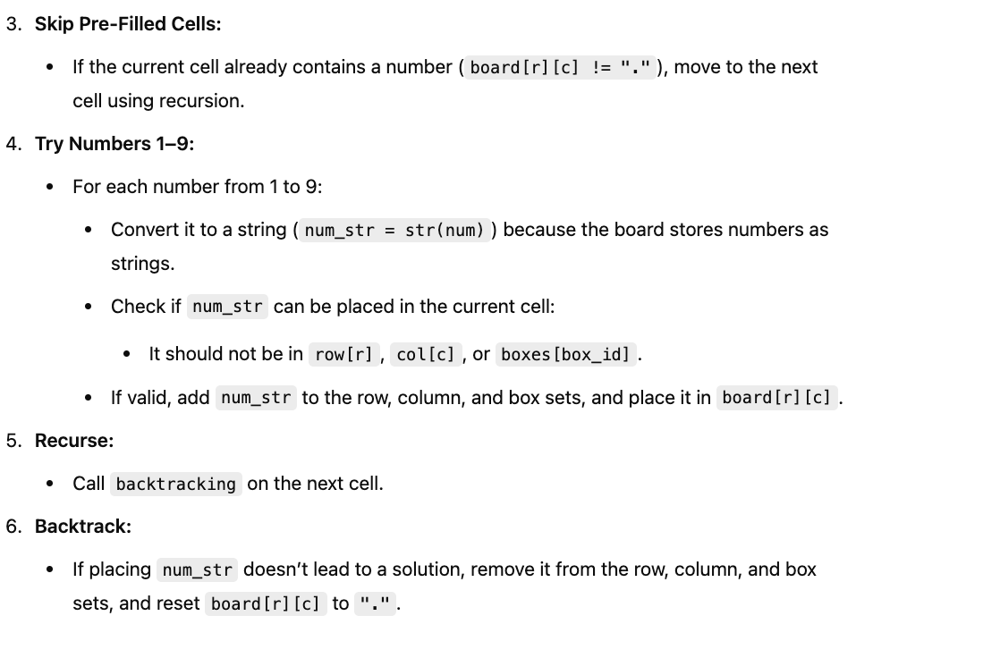

In [7]:
class Solution:
    def solveSudoku(self, board: List[List[str]]) -> None:
        """
        Do not return anything, modify board in-place instead.
        """
        # Track used numbers for rows, columns, and boxes
        row = [set() for _ in range(9)]
        col = [set() for _ in range(9)]
        boxes = [set() for _ in range(9)]

        # Initialize sets with existing numbers
        for i in range(9):
            for j in range(9):
                if board[i][j] != ".":
                    num = board[i][j]
                    row[i].add(num)
                    col[j].add(num)
                    box_id = (i // 3) * 3 + (j // 3)
                    boxes[box_id].add(num)

        def backtracking(r, c):
            nonlocal solved

            # If we reach beyond the last row, the board is solved
            if r == 9:
                solved = True
                return

            # Calculate the next cell to visit
            new_r = r + (c + 1) // 9
            new_c = (c + 1) % 9

            if board[r][c] != ".":
                # Skip filled cells
                backtracking(new_r, new_c)
            else:
                # Try placing numbers 1-9 in the current cell
                for num in range(1, 10):
                    num_str = str(num)  # Convert to string for consistency
                    box_id = (r // 3) * 3 + (c // 3)
                    if (num_str not in row[r]) and (num_str not in col[c]) and (num_str not in boxes[box_id]):
                        # Place the number
                        row[r].add(num_str)
                        col[c].add(num_str)
                        boxes[box_id].add(num_str)
                        board[r][c] = num_str

                        # Recur to the next cell
                        backtracking(new_r, new_c)

                        # Backtrack if not solved
                        if not solved:
                            row[r].remove(num_str)
                            col[c].remove(num_str)
                            boxes[box_id].remove(num_str)
                            board[r][c] = "."

        solved = False
        backtracking(0, 0)


In [9]:
board = [
    ["5", "3", ".", ".", "7", ".", ".", ".", "."],
    ["6", ".", ".", "1", "9", "5", ".", ".", "."],
    [".", "9", "8", ".", ".", ".", ".", "6", "."],
    ["8", ".", ".", ".", "6", ".", ".", ".", "3"],
    ["4", ".", ".", "8", ".", "3", ".", ".", "1"],
    ["7", ".", ".", ".", "2", ".", ".", ".", "6"],
    [".", "6", ".", ".", ".", ".", "2", "8", "."],
    [".", ".", ".", "4", "1", "9", ".", ".", "5"],
    [".", ".", ".", ".", "8", ".", ".", "7", "9"],
]
Solution().solveSudoku(board)

board


[['5', '3', '4', '6', '7', '8', '9', '1', '2'],
 ['6', '7', '2', '1', '9', '5', '3', '4', '8'],
 ['1', '9', '8', '3', '4', '2', '5', '6', '7'],
 ['8', '5', '9', '7', '6', '1', '4', '2', '3'],
 ['4', '2', '6', '8', '5', '3', '7', '9', '1'],
 ['7', '1', '3', '9', '2', '4', '8', '5', '6'],
 ['9', '6', '1', '5', '3', '7', '2', '8', '4'],
 ['2', '8', '7', '4', '1', '9', '6', '3', '5'],
 ['3', '4', '5', '2', '8', '6', '1', '7', '9']]

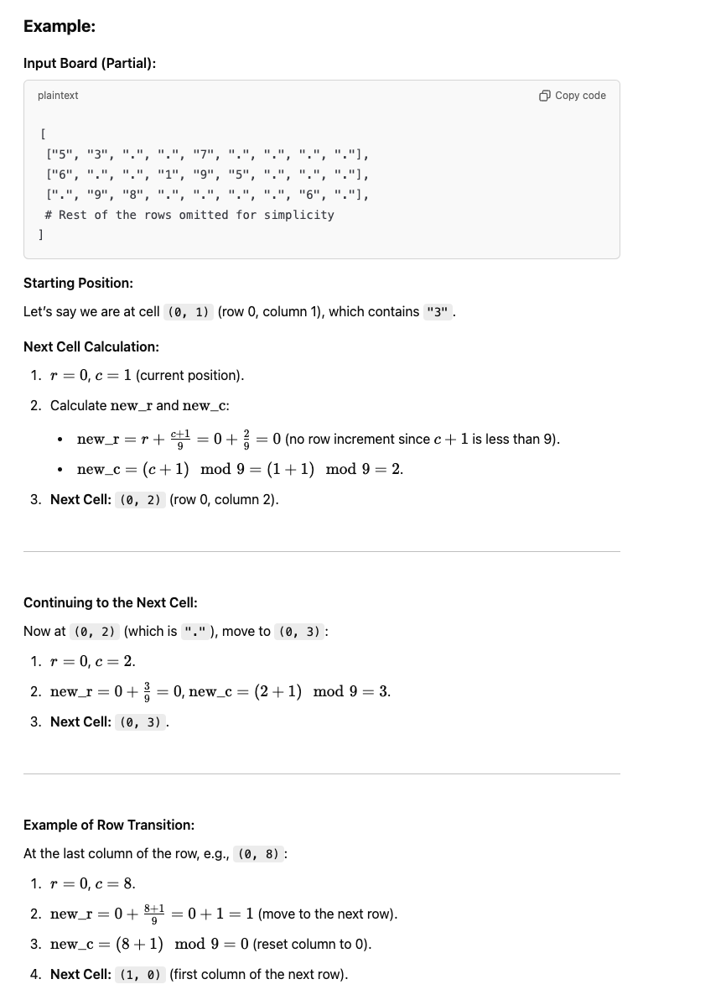

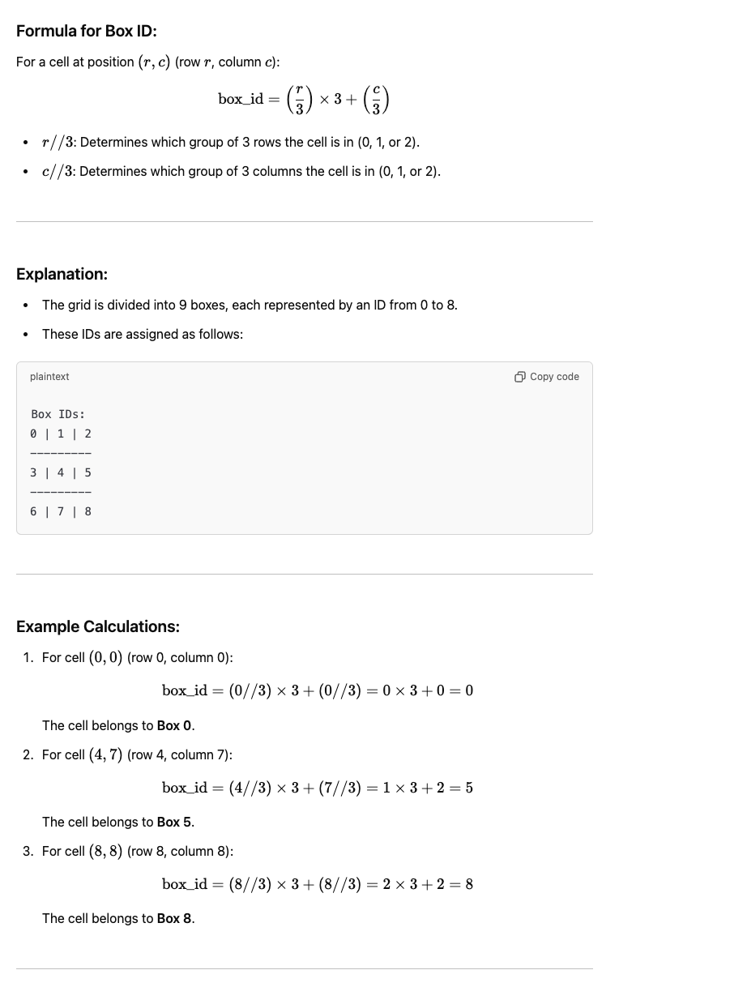

************************************************************************************************************************************************************************************************************

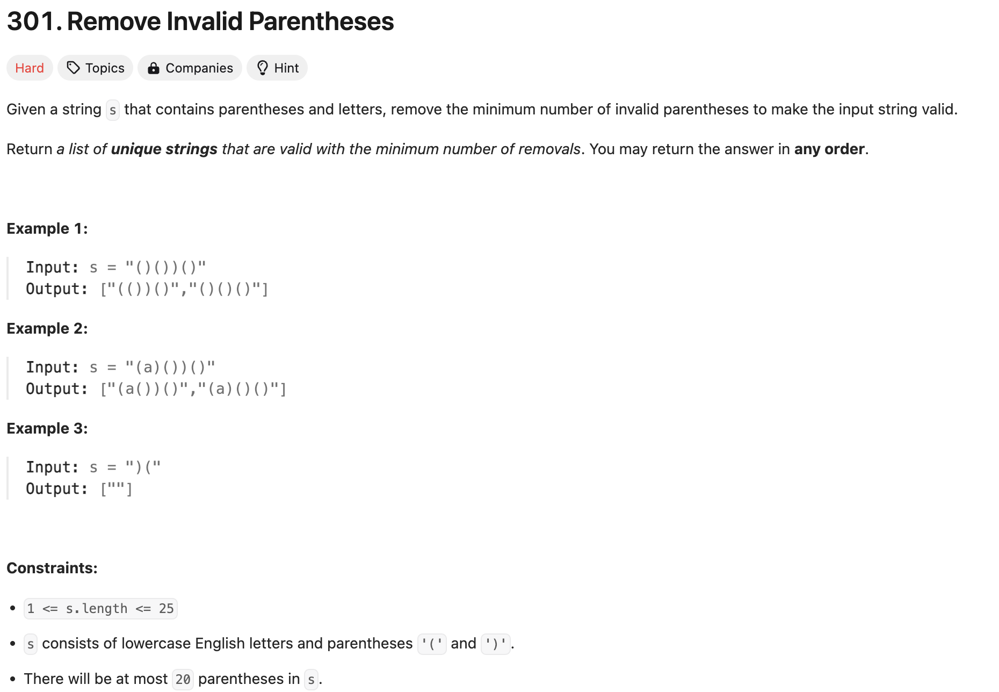

In [10]:
from collections import deque

class Solution:
    def removeInvalidParentheses(self, s: str) -> List[str]:
        def is_valid(string):
            count = 0
            for char in string:
                if char == '(':
                    count += 1
                elif char == ')':
                    count -= 1
                if count < 0:  # More ')' than '('
                    return False
            return count == 0  # Ensure balanced

        queue = deque([s])
        visited = set([s])  # To avoid duplicates
        found = False
        result = []

        while queue:
            current = queue.popleft()

            if is_valid(current):
                result.append(current)
                found = True

            if found:
                continue  # No need to generate more levels

            for i in range(len(current)):
                if current[i] not in "()":
                    continue
                next_string = current[:i] + current[i+1:]  # Remove one parenthesis
                if next_string not in visited:
                    visited.add(next_string)
                    queue.append(next_string)

        return result


In [18]:
s = ")("
Solution().removeInvalidParentheses(s)


['']

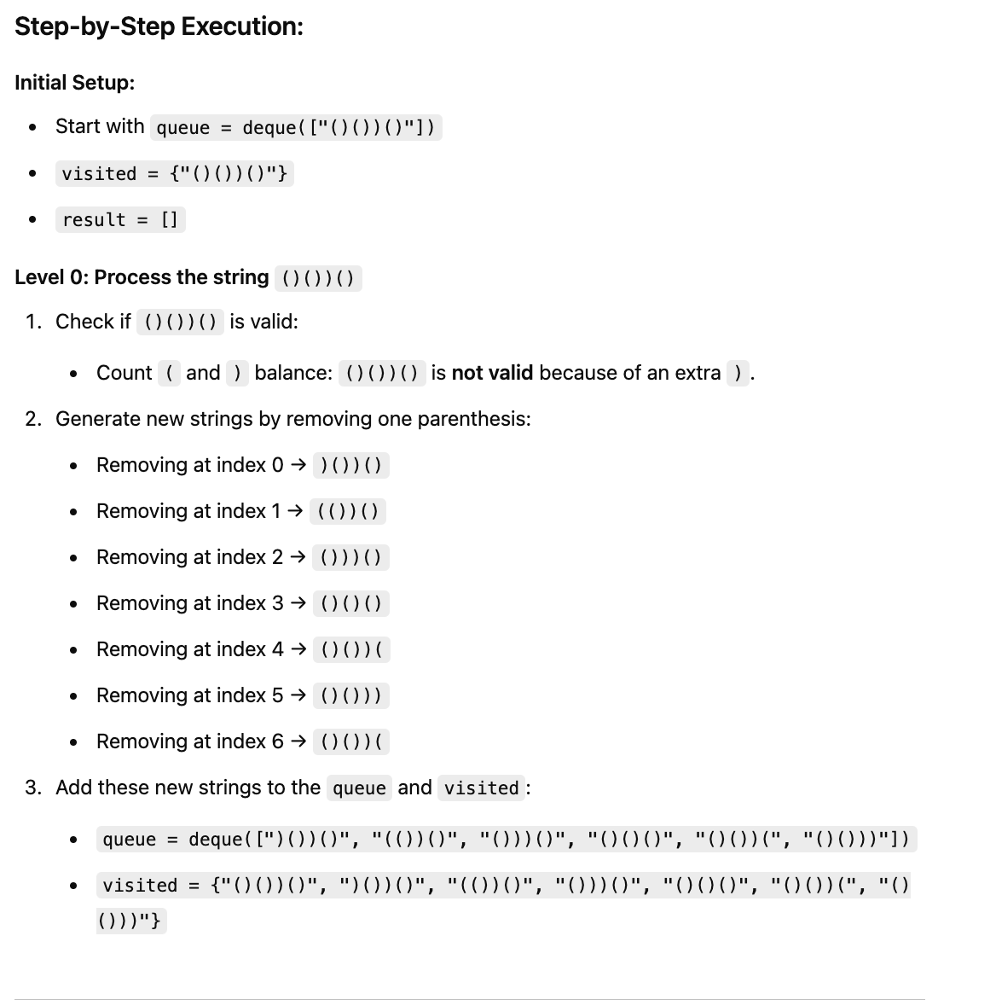

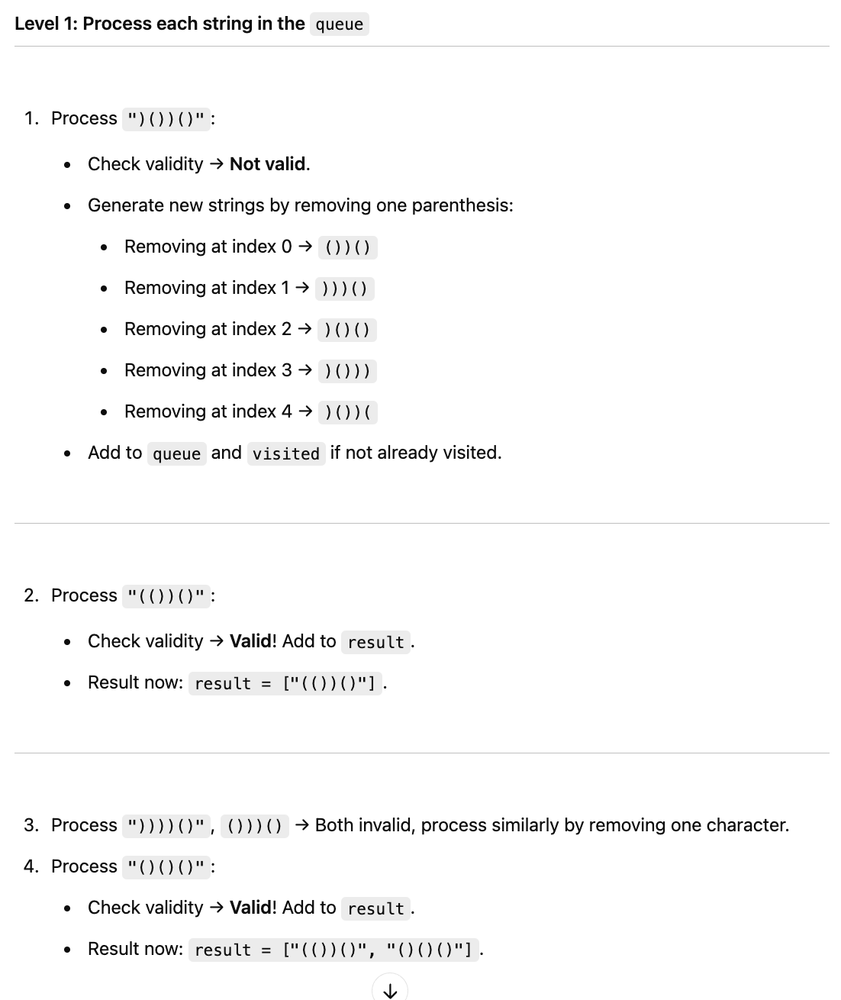

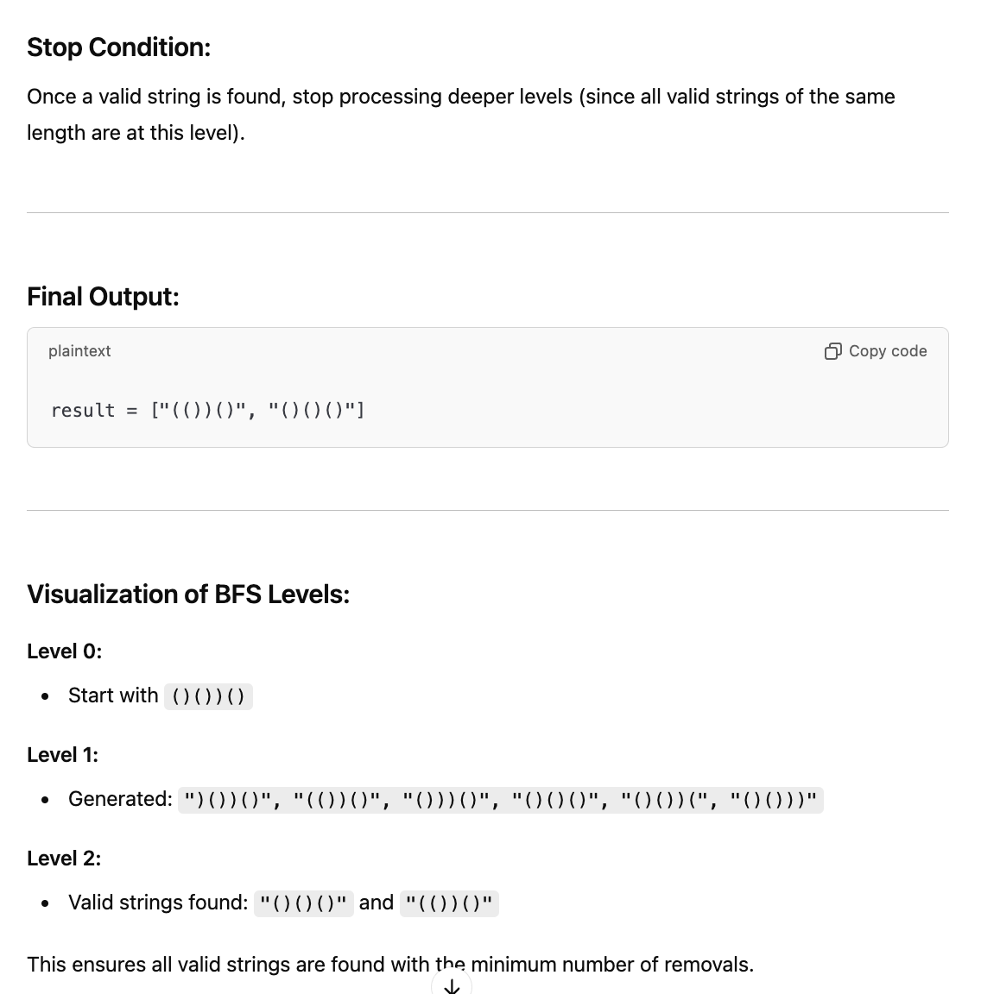

************************************************************************************************************************************************************************************************************

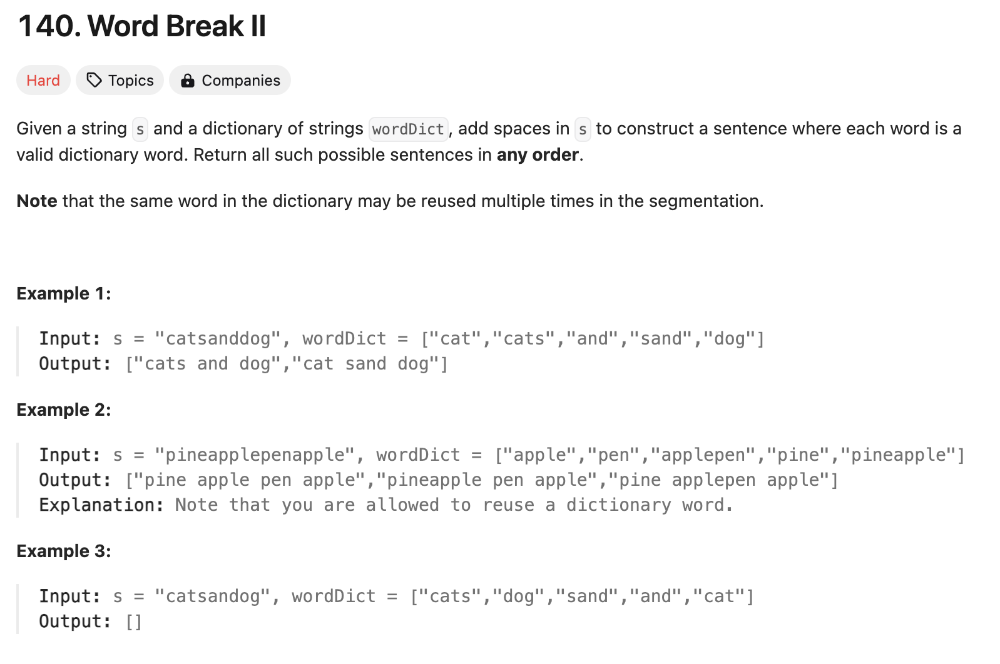

In [19]:
from typing import List

class Solution:
    def wordBreak(self, s: str, wordDict: List[str]) -> List[str]:
        wordSet = set(wordDict)  # Use a set for faster lookups
        memo = {}  # Memoization dictionary
        
        def dfs(substring):
            if substring in memo:  # Check if the result is already computed
                return memo[substring]
            if not substring:  # Base case: if the string is empty
                return [""]
            
            result = []
            for i in range(1, len(substring) + 1):
                prefix = substring[:i]
                if prefix in wordSet:  # Check if prefix is valid
                    # Recursively solve for the remaining string
                    suffix_results = dfs(substring[i:])
                    for sentence in suffix_results:
                        if sentence:
                            result.append(prefix + " " + sentence)
                        else:
                            result.append(prefix)
            
            memo[substring] = result  # Cache the result
            return result
        
        return dfs(s)


In [20]:
s = "catsanddog"
wordDict = ["cat", "cats", "and", "sand", "dog"]
Solution().wordBreak(s,wordDict)

['cat sand dog', 'cats and dog']

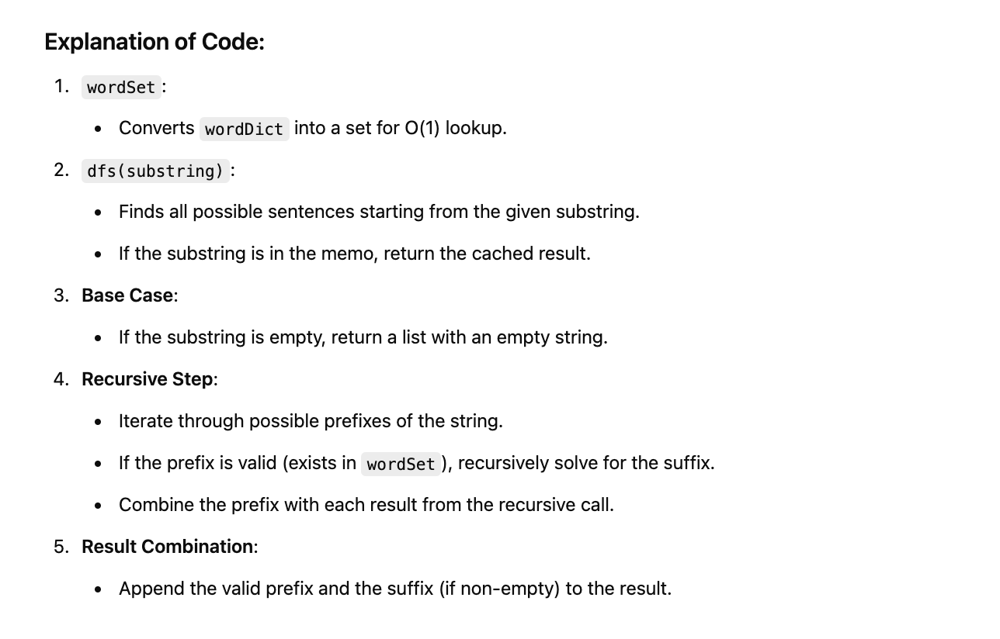

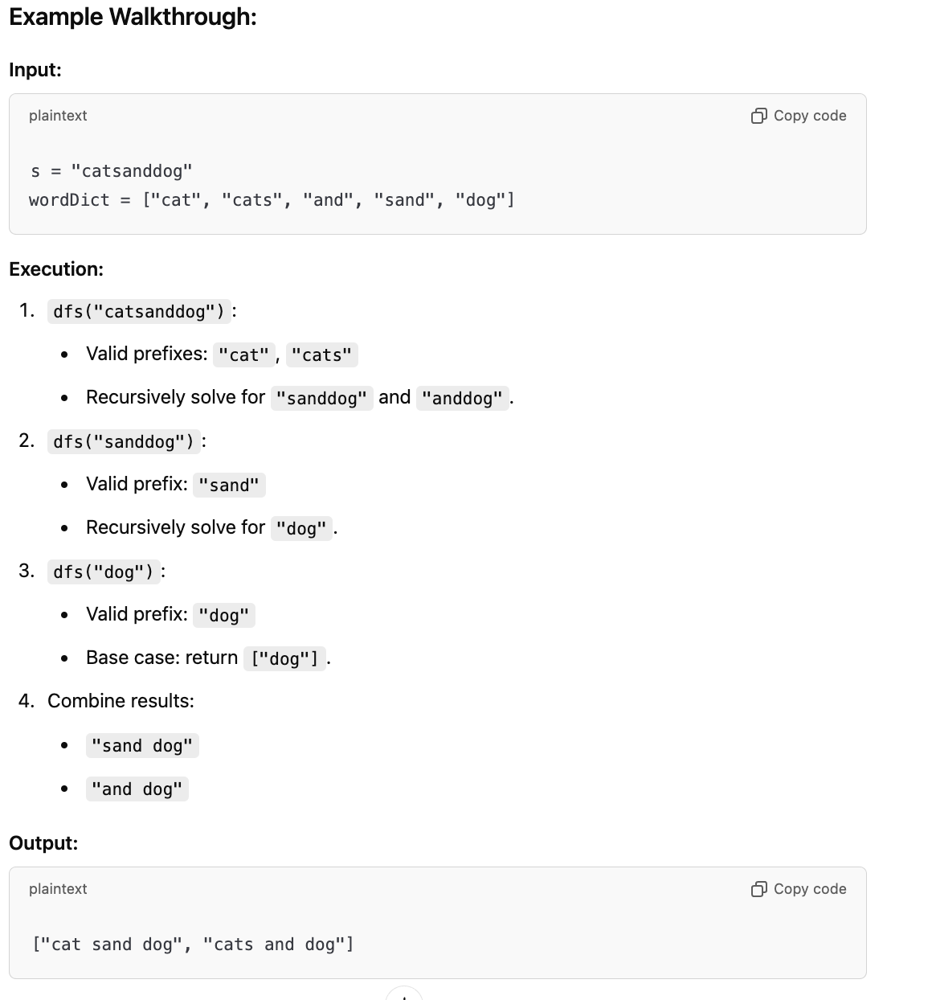